In [1]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from nltk.util import ngrams
from nltk.tokenize import word_tokenize
from nltk import sent_tokenize
from wordcloud import WordCloud, STOPWORDS, ImageColorGenerator
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from scipy import stats
%matplotlib inline  

In [2]:
#Define wordking directory
cwd = os.getcwd()
print(cwd)

/Users/siegfried/Documents/springboard/capstone1/capstone_1


This is a study motivated by the line of Amazon’s Echo device with screens, such as Echo Show and Echo Spot. The fundamental question here is: are the Alexa-enabled Echo devices better with a screen? 

This study will investigate the user experience based on Amazon reviews submitted on five Echo products, including 3 devices with screen and 2 screen-less smart speakers:

Echo Show 1st Generation (with screen, #reviews = 4000)

Echo Show 2nd Generation (with screen, #reviews = 2048)

Echo Spot 1st Generation (with screen, #reviews = 4000)

Echo Plus 1st Generation (screen-less, #reviews = 3208)

Echo Plus 2nd Generation (screen-less, #reviews = 1832)

All reviews were extracted at the end of February, 2019. Up to 4000 reviews were extracted from Amazon for each of the devices.

In [3]:
reviews_echo_show_1stgen = cwd+'/data/amazon_reviews_echo_show_1stgen_022819.csv'
reviews_echo_show_2ndgen = cwd+'/data/amazon_reviews_echo_show_2ndgen_022819.csv'
reviews_echo_spot = cwd+'/data/amazon_reviews_echo_spot_022819_2_n4001.csv'
reviews_echo_plus = cwd+'/data/amazon_reviews_echo_plus_022819.csv'
reviews_echo_plus_2ndgen = cwd+'/data/amazon_reviews_echo_plus_2ndgen_022819.csv'

reviews_echoshow1 = pd.read_csv(reviews_echo_show_1stgen)
reviews_echoshow2 = pd.read_csv(reviews_echo_show_2ndgen)
reviews_echospot1 = pd.read_csv(reviews_echo_spot)
reviews_echoplus1 = pd.read_csv(reviews_echo_plus)
reviews_echoplus2 = pd.read_csv(reviews_echo_plus_2ndgen)

reviews_echoshow1['product'] = 'Echo Show 1st generation'
reviews_echoshow2['product'] = 'Echo Show 2nd generation'
reviews_echospot1['product'] = 'Echo Spot 1st generation'
reviews_echoplus1['product'] = 'Echo Plus 1st generation'
reviews_echoplus2['product'] = 'Echo Plus 2nd generation'

The reviews were downloaded using the web scrapper implemented in Chrome. The detailed procedures are outlined as follow:

https://www.scrapehero.com/amazon-review-scraper/

The scrapper extracts review information, including author, title, date, review content, and star rating, from each product page, and the reports, with up to 4000 reviews per product, are saved as csv files.

The reviews are relatively clean. This study will focus on the review titles, review contents, star ratings and review submission dates. For text data, including titles and contents, punctuations were removed, and lower case was applied. Both reviews and titles were tokenized using the NLTK package, with stop words removed. Bigram and trigram tokens were also generated by linking unigram tokens with underscore. Character count and word count were also computed for both title and content to measure text length. Star ratings, captured as a string in the format of  “X.0 out of 5 stars”, was converted to integers. A handful of invalid reviews have a star rating of 0, which were removed from the dataset. No missing data was otherwise found in these key columns.


In [4]:
def process_tokens(x):
    wlist = []
    
    #punctuation table
    import string
    punct_table = str.maketrans('','',string.punctuation)
    
    #stop words filter
    from nltk.corpus import stopwords
    stopwords_list = set(stopwords.words('english'))

    #change all words to lower case and remove punctuation
    for w in x:
        new_w = w.lower().translate(punct_table)
        #keep words that are alphabetic and not in the stop words list
        if new_w.isalpha() and not new_w in stopwords_list:
            wlist.append(new_w)

    #return processed word list
    return(wlist)

def lower_case_and_remove_punct(text):
    #punctuation table
    import string
    punct_table = str.maketrans('','',string.punctuation)
    new_text = str(text).lower().translate(punct_table)
    #new_text = text.translate(punct_table)
    return(new_text)

def tokens_to_bigrams(tokens, n=2, sep="_"):  
    return [sep.join(tokens[i:i+n]) for i in range(len(tokens)-n+1)]

def tokens_to_trigrams(tokens, n=3, sep="_"):
    return [sep.join(tokens[i:i+n]) for i in range(len(tokens)-n+1)]

def process_data_and_tokenize(df):
    df['date']=pd.to_datetime(df['date'])
    df['star_rating'] = df.rating.str.replace('.0 out of 5 stars','').fillna('0')
    df['star_rating'] = pd.to_numeric(df['star_rating'])
    df['title_length_char'] = df['title'].apply(lambda x: len(str(x)))
    df['review_length_char'] = df['content'].apply(lambda x: len(str(x)))
    df['title_length'] = df['title'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(lambda x: len(x))
    df['review_length'] = df['content'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(lambda x: len(x))
    df['title_preprocessed_tokenized_words'] = df['title'].astype(str).apply(word_tokenize)
    df['review_preprocessed_tokenized_words'] = df['content'].astype(str).apply(word_tokenize)    
    df['title_tokenized_words'] = df['title_preprocessed_tokenized_words'].apply(process_tokens)
    df['review_tokenized_words'] = df['review_preprocessed_tokenized_words'].apply(process_tokens) 
    df['title_tokenized_words_bigrams'] = df['title'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(tokens_to_bigrams)
    df['review_tokenized_words_bigrams'] = df['content'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(tokens_to_bigrams)
    df['title_tokenized_words_trigrams'] = df['title'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(tokens_to_trigrams)
    df['review_tokenized_words_trigrams'] = df['content'].apply(lower_case_and_remove_punct).apply(word_tokenize).apply(tokens_to_trigrams)
    df2 = df[df['star_rating'] != 0]
    return(df2)

In [5]:
#Process data
echoshow1 = process_data_and_tokenize(reviews_echoshow1)
echoshow2 = process_data_and_tokenize(reviews_echoshow2)
echospot1 = process_data_and_tokenize(reviews_echospot1)
echoplus1 = process_data_and_tokenize(reviews_echoplus1)
echoplus2 = process_data_and_tokenize(reviews_echoplus2)

In [6]:
#Calculate star rating statistics
def star_rating_analysis(df,screen_opt):

    ctdf = df.groupby('star_rating').count().reset_index()[['star_rating','content']].copy()
    mndf = df.groupby('star_rating').mean().reset_index()[['star_rating','title_length','review_length']].copy()
    
    df2 = ctdf.merge(mndf,how='left',left_on='star_rating',right_on='star_rating',suffixes=('','_mn'))
    df2.rename(columns={"star_rating":"Star_rating","content": "Review_count","title_length":"Mean_title_length",'review_length':"Mean_review_length"},inplace = True)
    df2['Product']=df['product'][0]
    df2['Total_count']=df.star_rating.count()
    df2['Review_count_percentage']=df2['Review_count']*100/df2['Total_count']
    df2['Overall_mean_star_rating']=df.star_rating.mean()
    df2['Overall_mean_title_length']=df.title_length.mean()
    df2['Overall_mean_review_length']=df.review_length.mean()
    df2['Screen']=screen_opt

    return(df2)


In [7]:
star_es1=star_rating_analysis(echoshow1,'Yes')
star_es2=star_rating_analysis(echoshow2,'Yes')
star_et1=star_rating_analysis(echospot1,'Yes')
star_ep1=star_rating_analysis(echoplus1,'No')
star_ep2=star_rating_analysis(echoplus2,'No')

In [8]:
star_analysis = pd.concat([star_es1,star_es2,star_et1,star_ep1,star_ep2])
star_analysis

,Star_rating,Review_count,Mean_title_length,Mean_review_length,Product,Total_count,Review_count_percentage,Overall_mean_star_rating,Overall_mean_title_length,Overall_mean_review_length,Screen
0,1,541,6.565619,105.656192,Echo Show 1st generation,4000,13.525000,3.729250,6.515000,105.539500,Yes
1,2,378,7.253968,125.492063,Echo Show 1st generation,4000,9.450000,3.729250,6.515000,105.539500,Yes
2,3,551,7.308530,127.996370,Echo Show 1st generation,4000,13.775000,3.729250,6.515000,105.539500,Yes
3,4,683,7.102489,111.809663,Echo Show 1st generation,4000,17.075000,3.729250,6.515000,105.539500,Yes
4,5,1847,5.894965,92.403898,Echo Show 1st generation,4000,46.175000,3.729250,6.515000,105.539500,Yes
0,1,107,5.598131,103.205607,Echo Show 2nd generation,2048,5.224609,4.344238,4.520020,56.790527,Yes
1,2,116,5.844828,107.724138,Echo Show 2nd generation,2048,5.664062,4.344238,4.520020,56.790527,Yes
2,3,150,5.886667,111.940000,Echo Show 2nd generation,2048,7.324219,4.344238,4.520020,56.790527,Yes
3,4,267,4.715356,68.314607,Echo Show 2nd generation,2048,13.037109,4.344238,4.520020,56.790527,Yes
4,5,1408,4.146307,41.006392,Echo Show 2nd generation,2048,68.750000,4.344238,4.520020,56.790527,Yes


The first step to explore the reviews data is to examine the satisfaction from each of these productions.

In [9]:
overall_mean = star_analysis[star_analysis['Star_rating']==5][['Product','Overall_mean_star_rating','Overall_mean_title_length','Overall_mean_review_length','Screen']]
overall_mean

,Product,Overall_mean_star_rating,Overall_mean_title_length,Overall_mean_review_length,Screen
4,Echo Show 1st generation,3.729250,6.515000,105.539500,Yes
4,Echo Show 2nd generation,4.344238,4.520020,56.790527,Yes
4,Echo Spot 1st generation,4.371250,5.408750,63.162000,Yes
4,Echo Plus 1st generation,4.381858,5.240648,37.554863,No
4,Echo Plus 2nd generation,4.574236,4.200873,41.936681,No


In [10]:
#Visualize data
def hist_yvar_vs_xvar_onefig(df,xvar,yvar):
    plt_title1 = yvar+" vs "+xvar
    g1 = plt.figure(figsize=(20,6))   
    g1 = sns.catplot(x=xvar,y=yvar,hue='Screen',data=df,kind='bar')
    plt.subplots_adjust(top=0.8)
    g1.set_xticklabels(rotation=45, horizontalalignment='right', fontweight='light')
    g1.fig.suptitle(plt_title1,fontsize=16)
    plt.show()


def hist_len_vs_star(df,opt):
    plt_title1 = "Mean "+opt+" word count vs Star rating"
    yvar='Mean_'+opt+'_length'
    g1 = plt.figure(figsize=(20,6))   
    g1 = sns.catplot(x='Star_rating',y=yvar,hue='Product',col='Screen',data=df,kind='bar')
    plt.subplots_adjust(top=0.8)
    g1.fig.suptitle(plt_title1,fontsize=16)
    plt.show()


def hist_yvar_vs_xvar(df,xvar,yvar):
    plt_title1 = yvar+" vs "+xvar
    g1 = plt.figure(figsize=(20,6))   
    g1 = sns.catplot(x=xvar,y=yvar,hue='Product',col='Screen',data=df,kind='bar')
    plt.subplots_adjust(top=0.8)
    g1.fig.suptitle(plt_title1,fontsize=16)   
    plt.show()


Plot mean star rating and mean title/review length for each product:

<Figure size 1440x432 with 0 Axes>

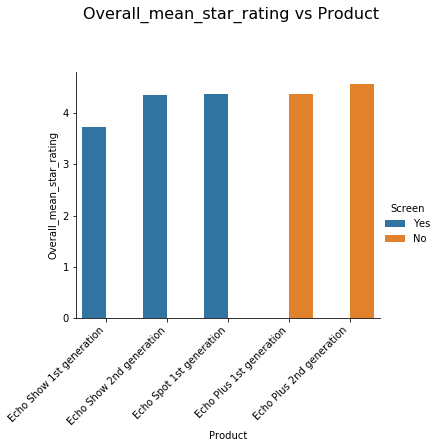

In [11]:
hist_yvar_vs_xvar_onefig(overall_mean,'Product','Overall_mean_star_rating')

<Figure size 1440x432 with 0 Axes>

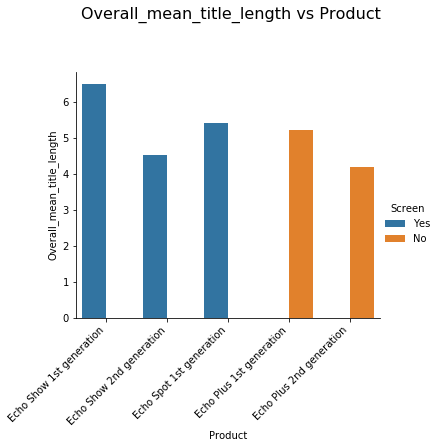

In [12]:
hist_yvar_vs_xvar_onefig(overall_mean,'Product','Overall_mean_title_length')

<Figure size 1440x432 with 0 Axes>

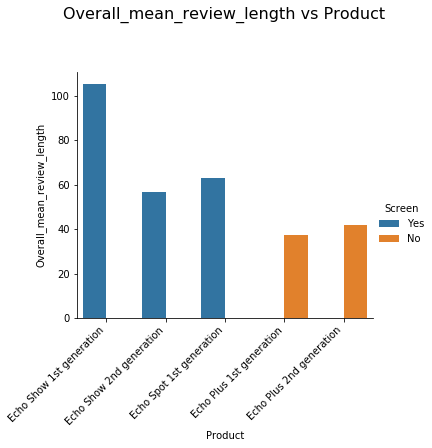

In [13]:
hist_yvar_vs_xvar_onefig(overall_mean,'Product','Overall_mean_review_length')

Overall, all devices appear to have good similar ratings. With the exception of Echo Show 1st Generation (mean star rating = 3.7), the other four devices scored more than 4 stars and the Echo Plus 2nd Generation has the best rating of 4.6. 

The review length was further examined. The mean word counts were calculated from title and contents of reviews for each device. 

<Figure size 1440x432 with 0 Axes>

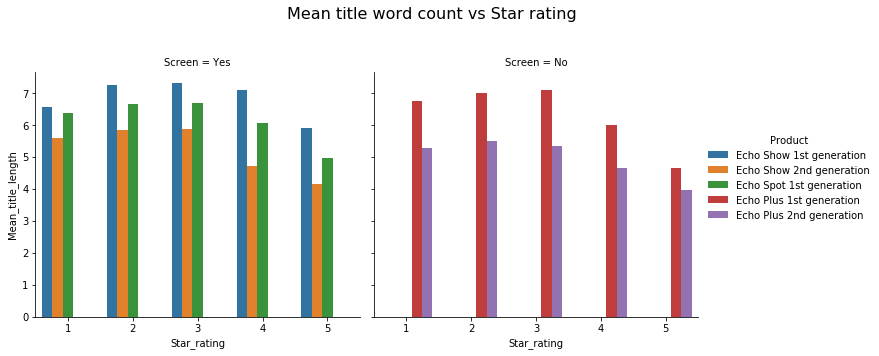

In [14]:
hist_len_vs_star(star_analysis,'title')

<Figure size 1440x432 with 0 Axes>

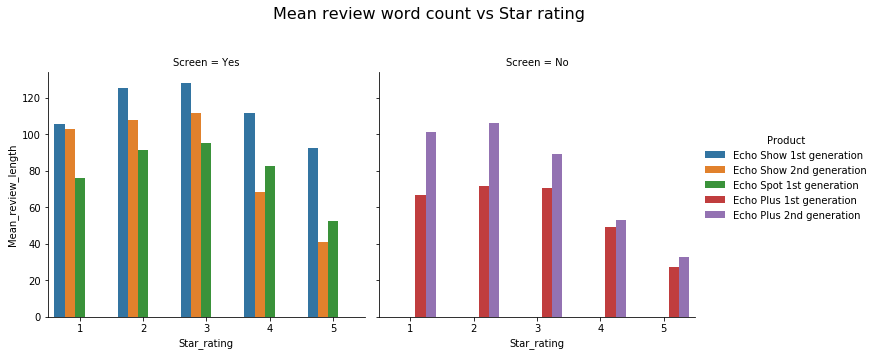

In [15]:
hist_len_vs_star(star_analysis,'review')

As shown above, the titles and review title and contents are shortest for 5-star reviews, and the word counts increase as the star rating decreases. Interestingly, the longest reviews are either 2-star or 3-star reviews, not the 1-star reviews. In addition, reviews for Echo Show and Echo Spot are generally longer than those for Echo Plus. The Echo Show 1st Generation has the longest reviews across all star ratings, while Echo Plus 1st Generation has the shortest reviews. In some cases, the difference is quite significant. For example, the 5-star reviews of Echo Show 1st Generation have 92 words in average, which are 3 times as long as those 5-star reviews from Echo Plus 1st Generation. 

Text(0, 0.5, 'Overall_mean_review_length')

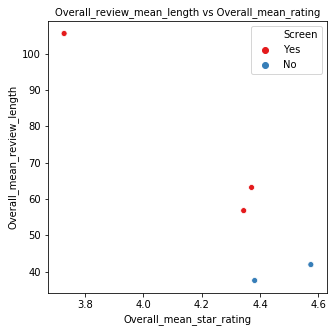

In [16]:
plt_title1 = "Overall_review_mean_length vs Overall_mean_rating"
xcol='Overall_mean_star_rating'
ycol='Overall_mean_review_length'
g1 = plt.figure(figsize=(5,5))
g1 = sns.scatterplot(x=overall_mean[xcol],y=overall_mean[ycol],
                     hue=overall_mean['Screen'],legend="full",palette="Set1")
g1.set_title(plt_title1,fontsize=10)
g1.set_xlabel(xcol,fontsize=10)
g1.set_ylabel(ycol,fontsize=10)

The mean review length was plotted against the mean star rating above, showing that reviewers, when they are not as satisfied with the device as reflected by the lower star rating, would write more. Interestingly, the two screen-less devices, with their relatively higher mean star ratings, have shorter reviews than the three devices with screen. 

The number of reviews and their relative proportion for each star-rating group are investigated below.

<Figure size 1440x432 with 0 Axes>

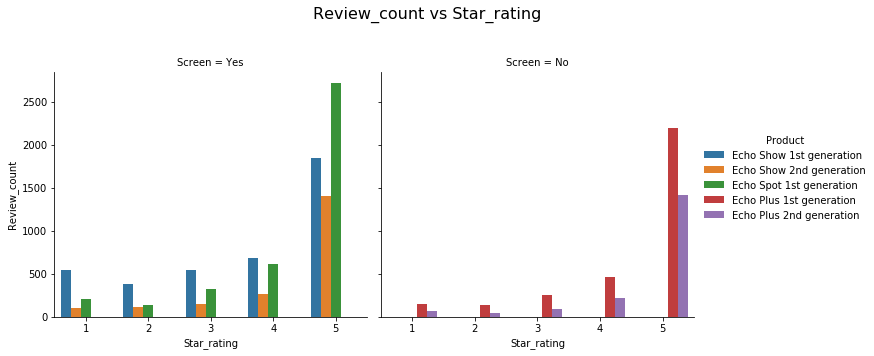

In [17]:
hist_yvar_vs_xvar(star_analysis,'Star_rating','Review_count')

<Figure size 1440x432 with 0 Axes>

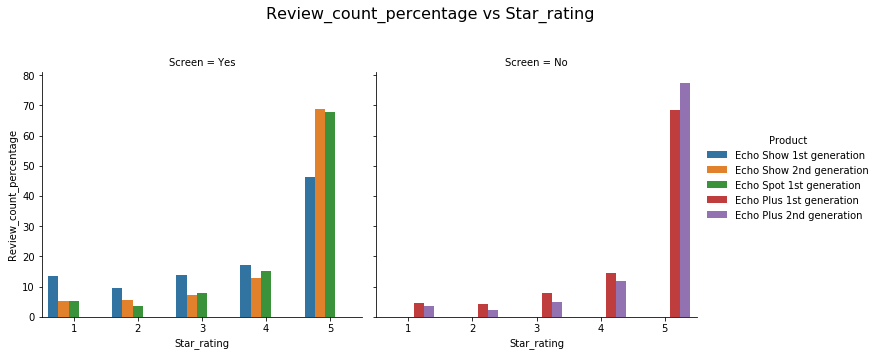

In [18]:
hist_yvar_vs_xvar(star_analysis,'Star_rating','Review_count_percentage')

The graphs show that the reviews for all the five selected devices are highly skewed with mostly 5-star reviews. The 5-star reviews made up for about 70% of the reviews for all devices but Echo Show 1st Generation, from which ~50% are 5-star reviews. 

The overall high mean star ratings can probably be explained by the skewed reviews. The above analysis also suggests that reviewer’s satisfaction might influence how much they write. Understanding the relationship between the reviewer’s sentiment and the review content would be of interest. However, being able to extract information regardless of the review’s length would be important. The next steps will include examining the reviews further by word cloud analysis, which would help identifying features that are liked and disliked by the reviewers, and by performing a sentiment analysis, which would allow us to measure and analyze the sentiments expressed quantitatively.


Word cloud analysis:

Monogram, bigram and trigram word cloud analyses were performed on both review titles and review contents of each star-rating group from all selected Echo devices.

In [19]:
def gen_title_review_wordclouds(df,ngrams=1,nmaxwords=50):
    title_text=''
    review_text=''
    if ngrams==1:
        for title in df.title_tokenized_words:
            for word in title:
                if len(word) > 3:
                    title_text= " ".join([title_text, word])        
        for review in df.review_tokenized_words:
            for word in review:
                if len(word) > 3:
                    review_text= " ".join([review_text, word])
    elif ngrams==2:
        for title in df.title_tokenized_words_bigrams:
            for word in title:
                if len(word) > 7:
                    title_text= " ".join([title_text, word])
        for review in df.review_tokenized_words_bigrams:
            for word in review:
                if len(word) > 7:
                    review_text= " ".join([review_text, word])
    elif ngrams==3:
        for title in df.title_tokenized_words_trigrams:
            for word in title:
                if len(word) > 11:
                    title_text= " ".join([title_text, word])
        for review in df.review_tokenized_words_trigrams:
            for word in review:
                if len(word) > 11:
                    review_text= " ".join([review_text, word])
    
    # Create stopword list:
    stopwords = set(STOPWORDS)
    stopwords.update(["echo", "show", "spot", "plus",
                      "the_echo","echo_show","echo_spot","echo_plus",
                      "with_the","like_the","would_be","there_is",
                      "this_device","the_device",
                      "this_product","the_product",
                      "this_thing","the_thing",
                      "it_would","would_be","does_not","there_is",
                      "that_the","i_thought","i_bought","than_the",
                      "has_been","have_been","it_has","have_the",
                      "you_have","you_want","that_you","and_they",
                      "have_the","has_the","with_this","would_have",
                      "the_echo_show","the echo_spot","the_echo_plus",
                      "my_echo_show","my_echo_spot","my_echo_plus",
                      "echo_show_is","echo_spot_is","echo_plus_is",
                      "the_new_echo","my_new_echo"
                     ])
            
    # Generate a word cloud image
    title_wordcloud = WordCloud(collocations=False, max_font_size=50, max_words=nmaxwords,stopwords=stopwords, background_color="white").generate(title_text)
    review_wordcloud = WordCloud(collocations=False, max_font_size=50, max_words=nmaxwords,stopwords=stopwords, background_color="white").generate(review_text)

    # Display the generated image:
    fig, (ax1, ax2) = plt.subplots(1,2, figsize=(40,10))

    plt_title1 = "Wordcloud of titles"
    ax1.set_title(plt_title1,fontsize=40)
    ax1.axis("off")
    im1 = ax1.imshow(title_wordcloud, interpolation='bilinear')

    plt_title2 = "Wordcloud of reviews"
    ax2.set_title(plt_title2,fontsize=40)
    ax2.axis("off")
    im2 = ax2.imshow(review_wordcloud, interpolation='bilinear')

    plt.tight_layout()
    plt.show()
    #return(title_text, review_text)

5-star reviews:

Echo Show Gen 1 5-star reviews:

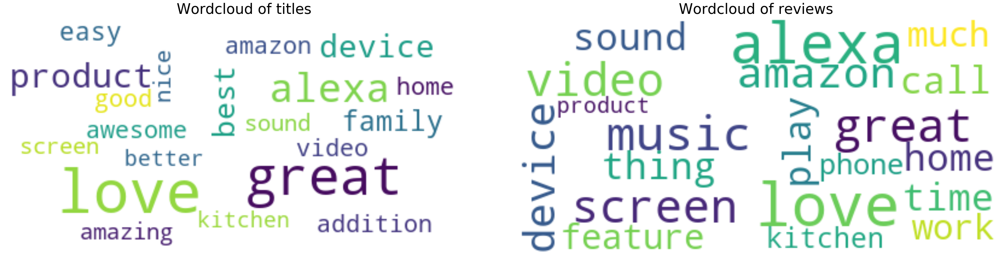

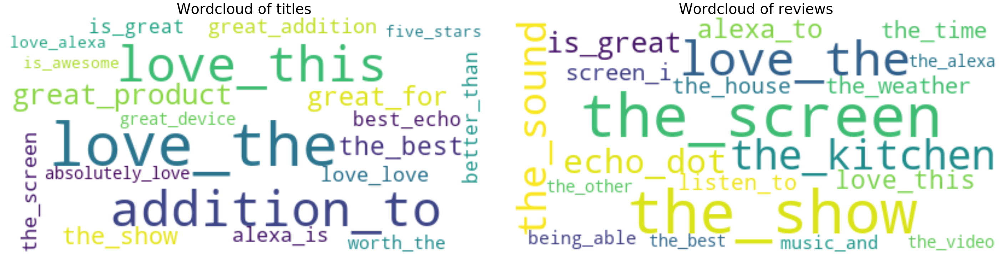

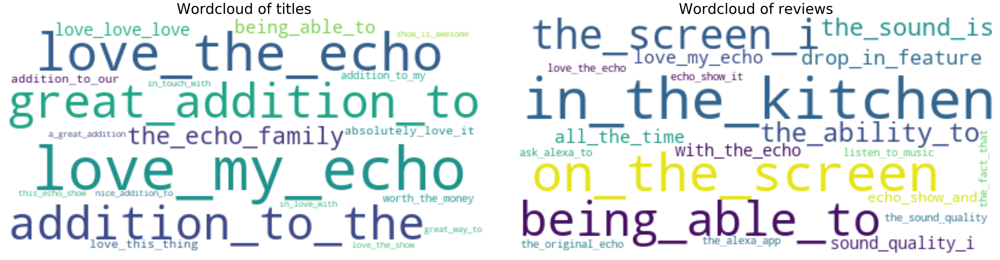

In [20]:
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==5],nmaxwords=20)
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==5],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==5],ngrams=3,nmaxwords=20)

Echo Show Gen 2 5-star reviews:

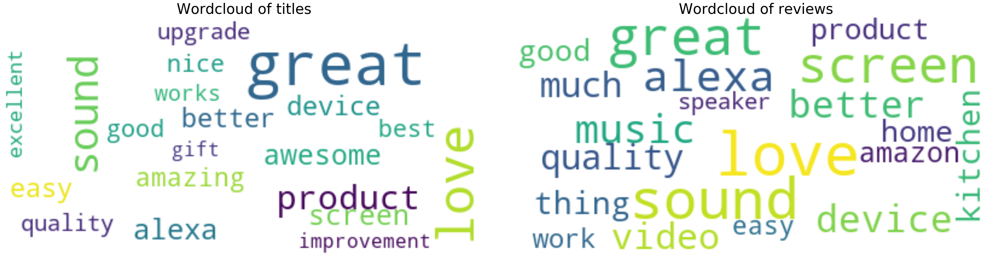

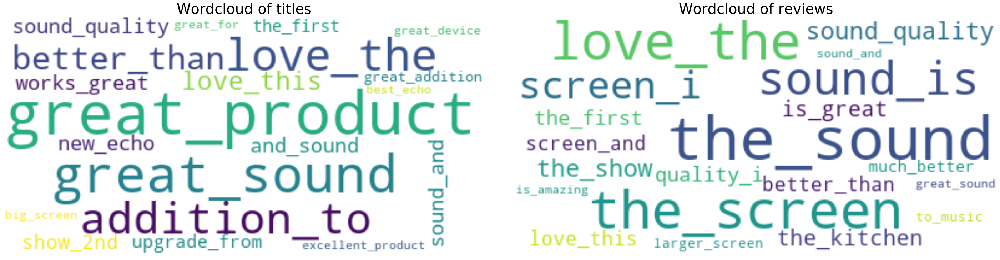

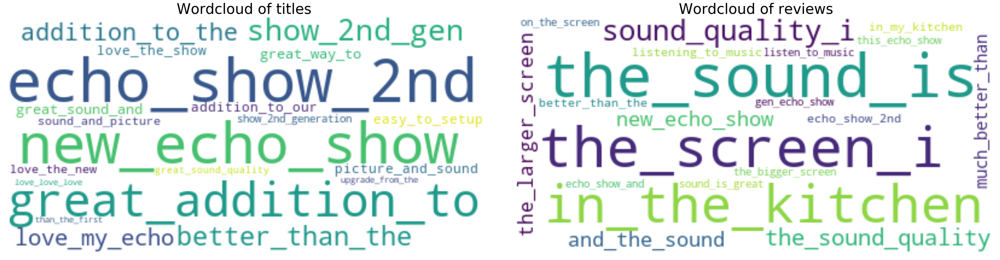

In [21]:
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==5],nmaxwords=20)
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==5],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==5],ngrams=3,nmaxwords=20)

Echo Spot Gen 1 5-star reviews:

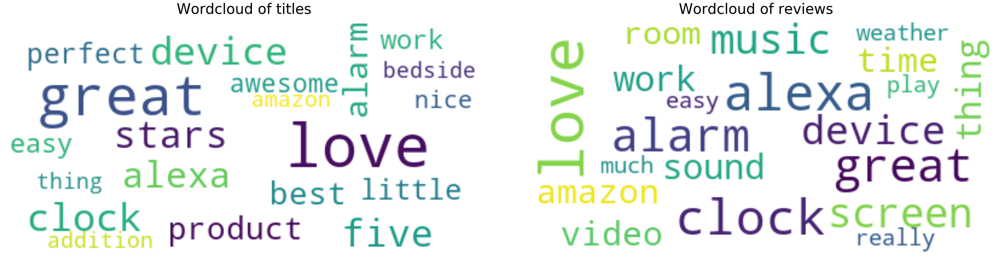

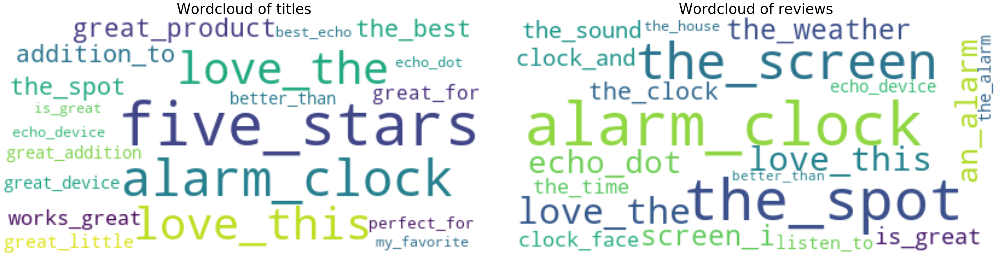

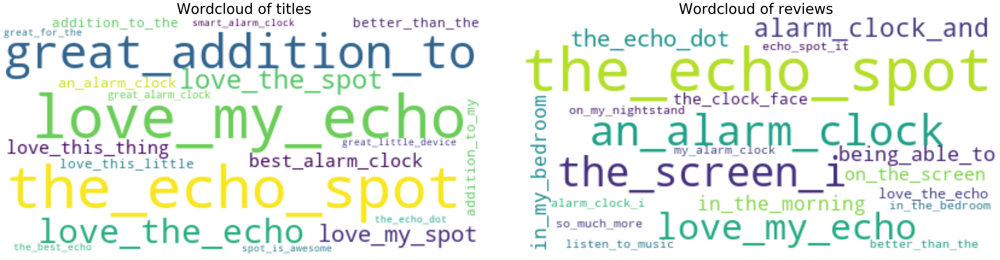

In [22]:
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==5],nmaxwords=20)
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==5],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==5],ngrams=3,nmaxwords=20)

Echo Plus Gen 1 5-star reviews:

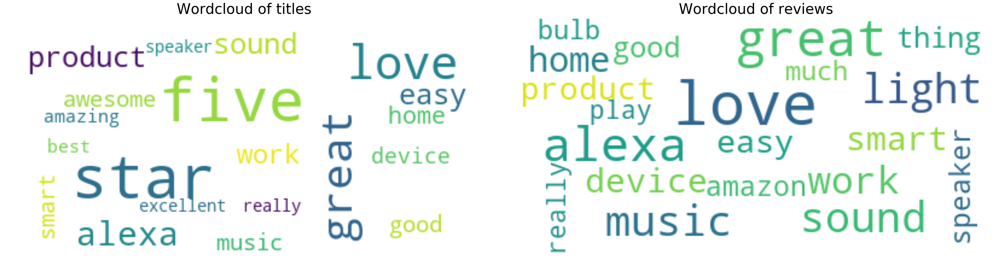

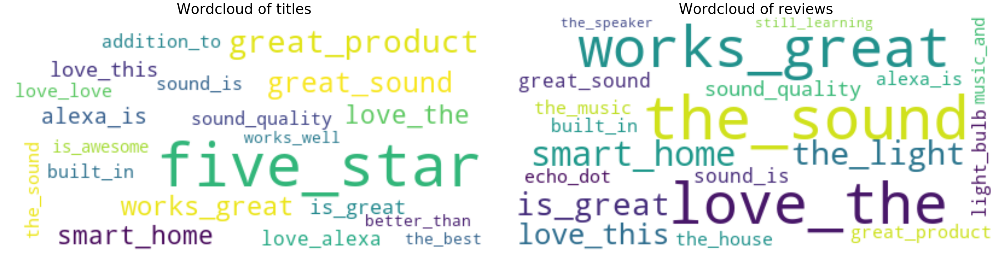

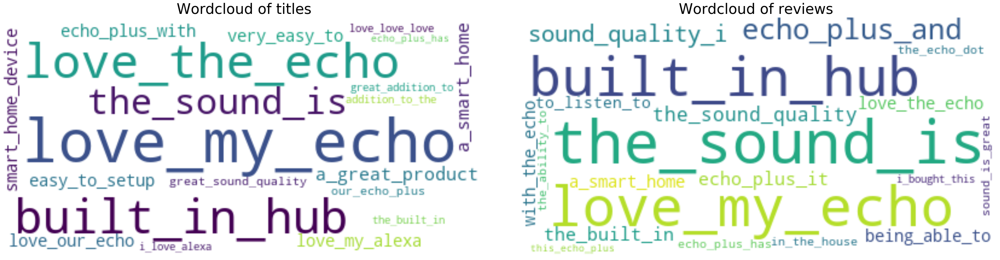

In [23]:
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==5],nmaxwords=20)
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==5],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==5],ngrams=3,nmaxwords=20)

Echo Plus Gen 2 5-star reviews:

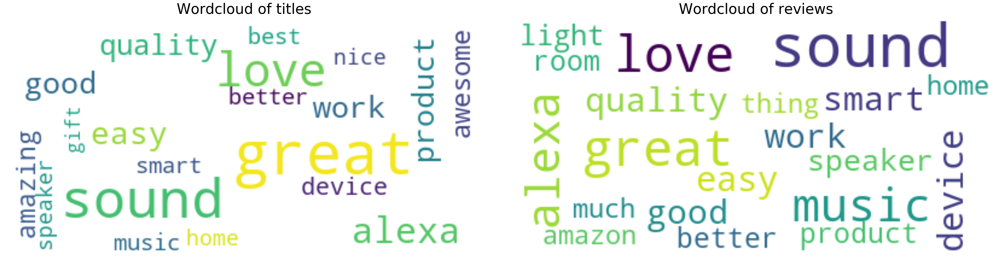

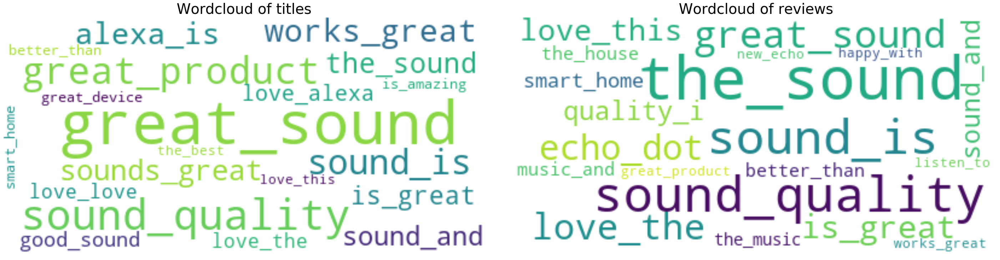

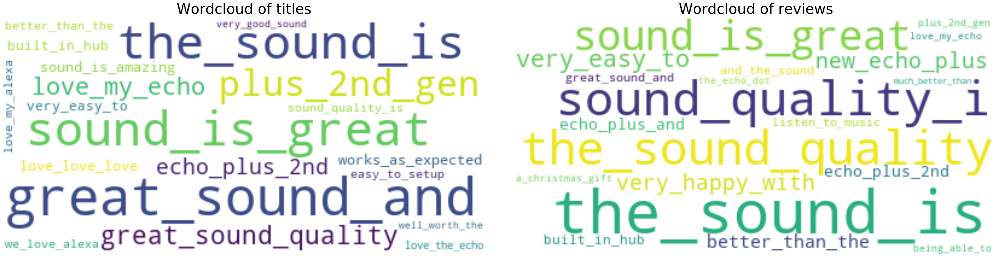

In [24]:
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==5],nmaxwords=20)
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==5],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==5],ngrams=3,nmaxwords=20)

The word cloud analyses from the 5-star reviews reveal some of the most popular features. Reviewers, who gave 5-star reviews to Echo Show 1st and 2nd Gen, did mention the screen. When Echo Show was released, Amazon promoted the device’s capability of making video calls via the Drop-in feature. Amazon also advertised Echo Show as a companion device in the kitchen. Both of these were present in the word clouds. Interestingly, reviewers of Echo Show 2nd Generation have mentioned “sound” a lot, which is similar to the reviews for the screen-less speakers. Reviews of Echo Spot, which is advertised as a smart alarm clock, show buyers do enjoy using the device as alarm clock. Unsurprisingly, Amazon’s smart voice assistant, Alexa, appears to be a prominent feature for all devices. Non-Amazon services that are compatible with Echo, such as Spotify, however, are not present, suggesting that these third-party services are overshadowed by the Amazon’s services.

1-star reviews:

Echo Show Gen 1 1-star reviews:

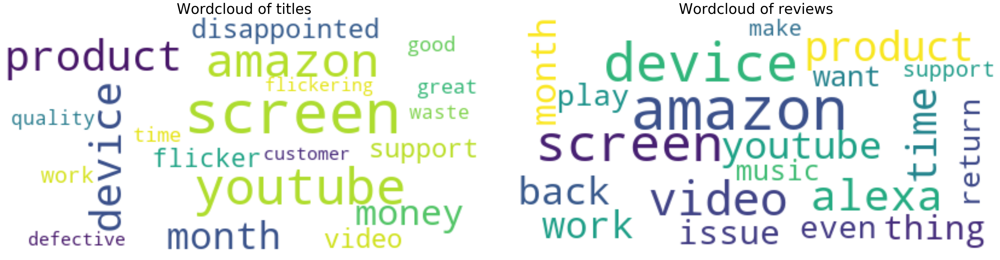

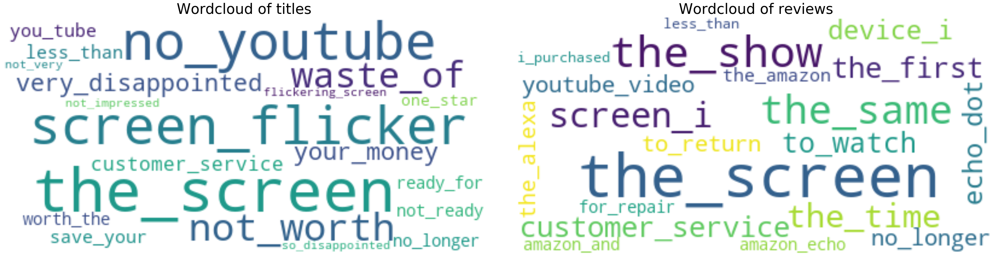

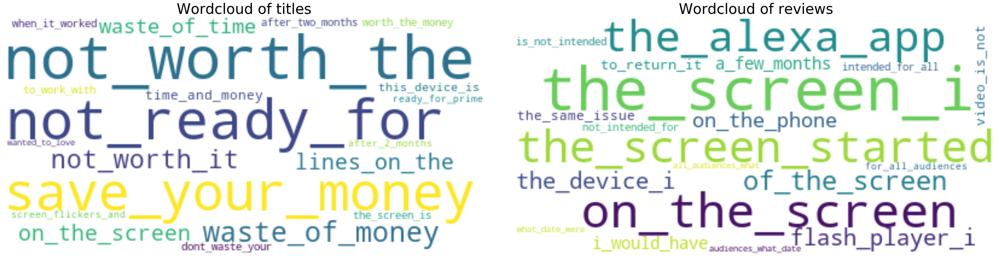

In [25]:
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==1],nmaxwords=20)
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==1],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoshow1[echoshow1['star_rating']==1],ngrams=3,nmaxwords=20)

Echo Show Gen 2 1-star reviews:

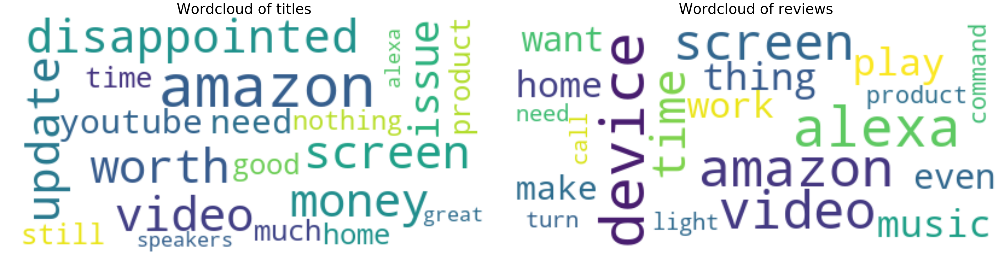

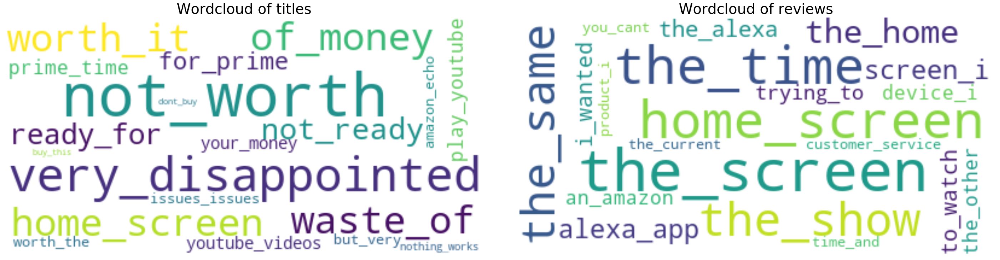

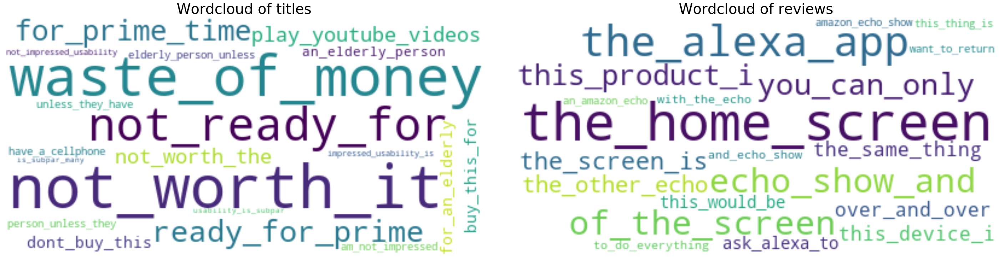

In [26]:
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==1],nmaxwords=20)
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==1],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoshow2[echoshow2['star_rating']==1],ngrams=3,nmaxwords=20)

Echo Spot Gen 1 1-star reviews:

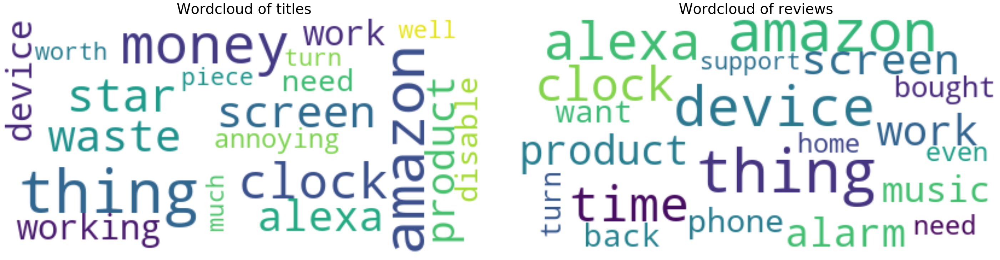

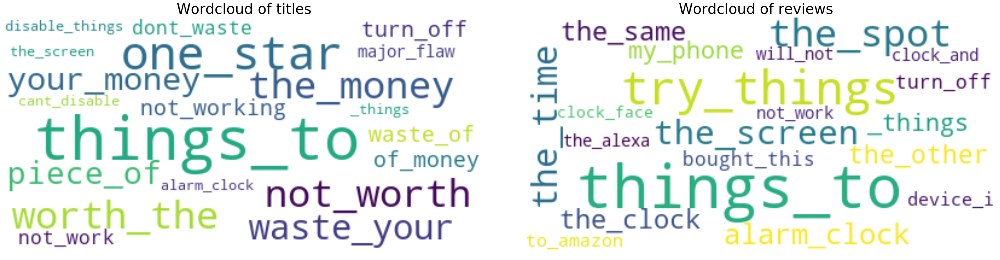

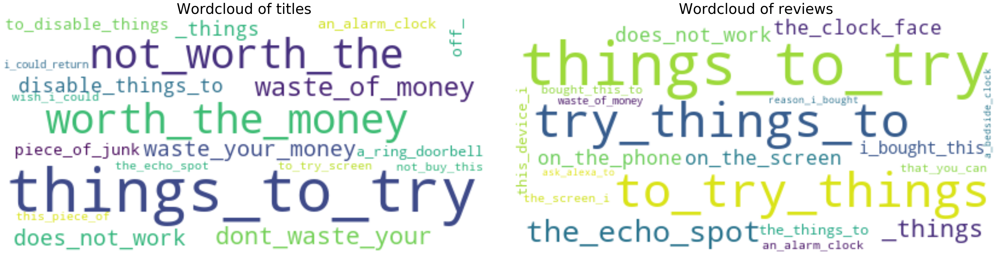

In [27]:
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==1],nmaxwords=20)
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==1],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echospot1[echospot1['star_rating']==1],ngrams=3,nmaxwords=20)

Echo Plus Gen 1 1-star reviews:

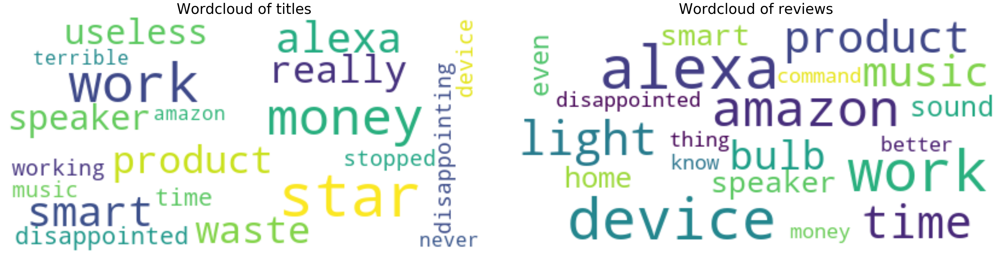

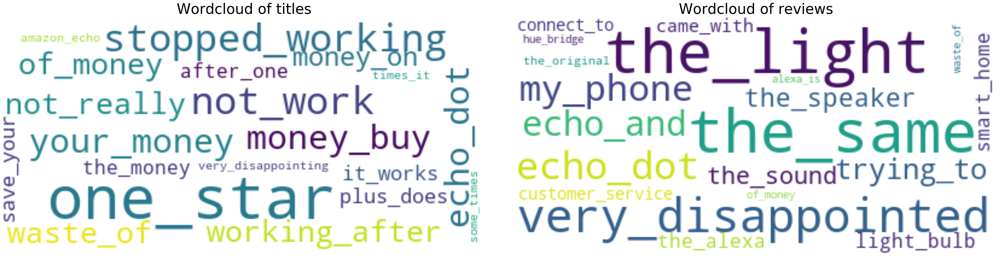

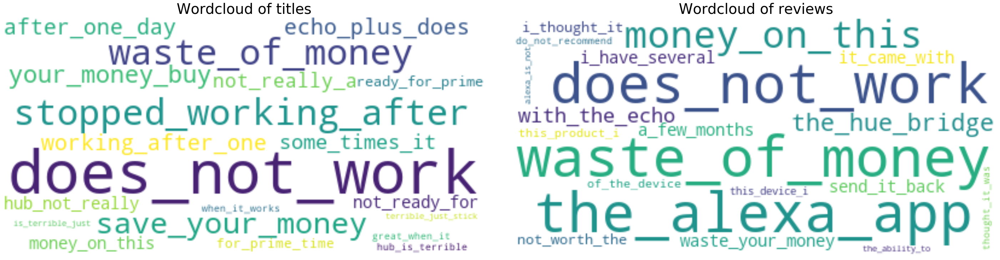

In [28]:
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==1],nmaxwords=20)
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==1],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoplus1[echoplus1['star_rating']==1],ngrams=3,nmaxwords=20)

Echo Plus Gen 2 1-star reviews:

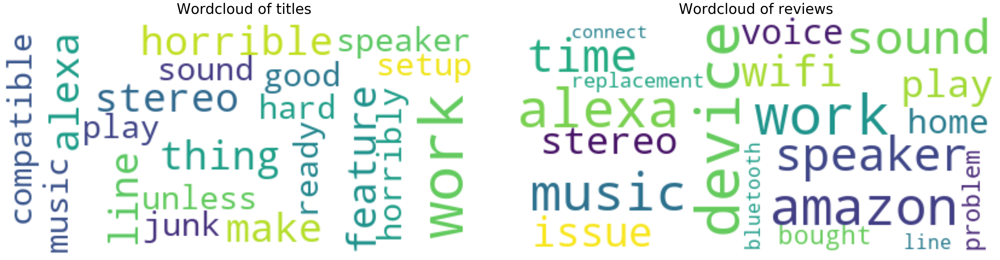

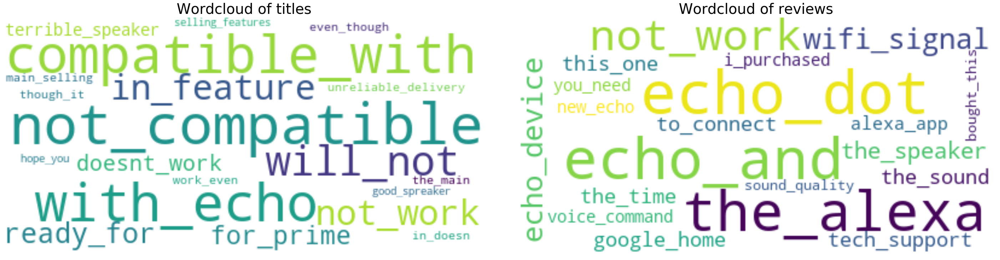

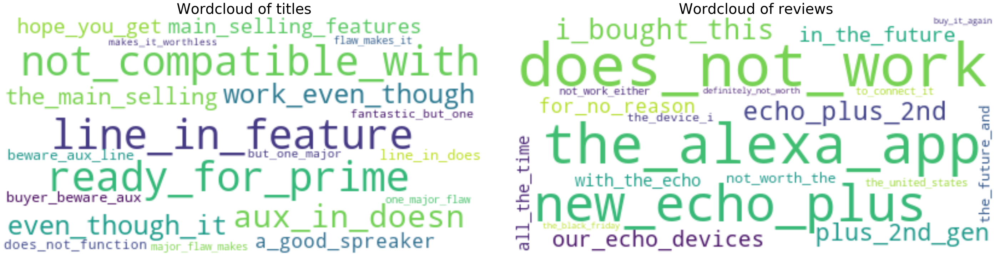

In [29]:
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==1],nmaxwords=20)
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==1],ngrams=2,nmaxwords=20)
gen_title_review_wordclouds(echoplus2[echoplus2['star_rating']==1],ngrams=3,nmaxwords=20)

Word clouds from 1-star reviews were generated to examine reviews at the other end of the spectrum. Interestingly, some features appear in both unigram word clouds from 5-star and 1-star reviews, such as Alexa, Amazon, music, screen (for Echo Shows and Echo Spot) and speaker (for Echo Pluses). This may suggest that 1-star reviewers also like these features or the 1-star reviewers actually dislike these features liked by many 5-star reviewers. The bigram and trigram word clouds do provide a bit more insights into reviews. For Echo Show devices, the reviews mentioned about YouTube videos and flash player, both of which is specific to screen-enabled devices. This likely relates to the rollout of Echo Show’s own YouTube app at its release. The Echo Show 1st generation was first released with a YouTube app, however, the app was then blocked by Google for some time. The “Alexa app” and “phone” also appear here for multiple devices, which could reflect on interactions with the Echo devices via the Alexa app in the phone. This analysis also helps identifying couple device-specific issues. Some Echo Plus 2nd generation devices might have a problem with WiFi signal (from bigram word cloud). Some 1-star reviewers also reported screen issues, such as screen flickering and lines on the screen, for Echo Show 1st generation. These issues, while do not appear in the word clouds of the review contents, was present the word clouds generated from the review titles.

The next step is to carry out sentiment analysis to quantify the sentiments expressed in these reviews. The goal would be to connect the results from sentiment analysis and the features/issues identified from the word cloud analysis, so we could profile and compare user experience of these Echo devices.

VADER sentiment analysis:

Valence Aware Dictionary and sEntiment Reasoner (VADER), a lexicon-based sentiment analysis tool developed specifically for social media, was utilized to analyze both the review titles and contents for the selected Echo devices. The analysis outputs 4 scores for both unidimensional and multidimensional sentiment evaluation:

•	Compound (Cpd) score. This score, ranging between -1 and 1, provides a single unidimensional measurement of sentiment. A “positive” text will score 0.05 or above, while a “negative” text will score -0.05 or below.  A score between -0.05 and 0.05 indicates a neutral sentiment.

•	Pos, Neu, Neg scores. These scores represent the relative proportions of positive (Pos), neutral (Neu) and negative (Neg) text in the inputs. Each score ranges from 0 to 1, and the sum of the scores equals 1. These allow multidimensional measurement of sentiments expressed in the input text.


In [30]:
def vadersent_analysis(df,cols):
    analyzer = SentimentIntensityAnalyzer()
    for col in cols:
        neg_list=[]
        neu_list=[]
        pos_list=[]
        cpd_list=[]
        ct=0
        for sentence in df[col]:
            ct+=1
            vs = analyzer.polarity_scores(str(sentence))
            #print("{:-<65} {}".format(sentence, str(vs)))
            #print(ct,str(vs))
            neg_list.append(vs['neg'])
            neu_list.append(vs['neu'])
            pos_list.append(vs['pos'])
            cpd_list.append(vs['compound'])
        
        neg_col = 'vader_neg_'+col
        neu_col = 'vader_neu_'+col
        pos_col = 'vader_pos_'+col
        cpd_col = 'vader_cpd_'+col
        
        df[neg_col] = neg_list
        df[neu_col] = neu_list
        df[pos_col] = pos_list
        df[cpd_col] = cpd_list
    
    return(df)

In [31]:
col_list = ['title','content']

vs_echoshow1 = vadersent_analysis(echoshow1,col_list)
vs_echoshow2 = vadersent_analysis(echoshow2,col_list)
vs_echospot1 = vadersent_analysis(echospot1,col_list)
vs_echoplus1 = vadersent_analysis(echoplus1,col_list)
vs_echoplus2 = vadersent_analysis(echoplus2,col_list)

/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:24: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:25: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentati

In [32]:
vs_echoshow1.head()

,web-scraper-order,web-scraper-start-url,author,title,date,content,rating,next,next-href,product,...,title_tokenized_words_trigrams,review_tokenized_words_trigrams,vader_neg_title,vader_neu_title,vader_pos_title,vader_cpd_title,vader_neg_content,vader_neu_content,vader_pos_content,vader_cpd_content
0,1551346435-14168,https://www.amazon.com/Echo-Show-1st-Generatio...,Enrique G. Cruz,"Echo ""no"" show?",2018-01-25,Has potential . I believe with future firmware...,3.0 out of 5 stars,Next page→,https://www.amazon.com/Echo-Show-1st-Generatio...,Echo Show 1st generation,...,[echo_no_show],"[has_potential_i, potential_i_believe, i_belie...",0.0,1.000,0.000,0.0000,0.035,0.913,0.052,0.5763
1,1551346776-15337,https://www.amazon.com/Echo-Show-1st-Generatio...,steve,Looks a little dated but we are very happy wit...,2017-07-22,We like it very much so far it's been our expe...,4.0 out of 5 stars,Next page→,https://www.amazon.com/Echo-Show-1st-Generatio...,Echo Show 1st generation,...,"[looks_a_little, a_little_dated, little_dated_...","[we_like_it, like_it_very, it_very_much, very_...",0.0,0.621,0.379,0.7572,0.000,0.791,0.209,0.8318
2,1551346568-14648,https://www.amazon.com/Echo-Show-1st-Generatio...,Michael H. Charles,A good product that will get better,2018-08-27,"All things considered, I think it’s a great pr...",4.0 out of 5 stars,Next page→,https://www.amazon.com/Echo-Show-1st-Generatio...,Echo Show 1st generation,...,"[a_good_product, good_product_that, product_th...","[all_things_considered, things_considered_i, c...",0.0,0.408,0.592,0.7003,0.000,0.764,0.236,0.9508
3,1551346386-13986,https://www.amazon.com/Echo-Show-1st-Generatio...,Denny Thomas,The digital assistant is truly amazing once yo...,2018-03-05,The Amazon Echo Show is a must have in your ho...,5.0 out of 5 stars,Next page→,https://www.amazon.com/Echo-Show-1st-Generatio...,Echo Show 1st generation,...,"[the_digital_assistant, digital_assistant_is, ...","[the_amazon_echo, amazon_echo_show, echo_show_...",0.0,0.676,0.324,0.7717,0.059,0.729,0.212,0.9822
4,1551346407-14067,https://www.amazon.com/Echo-Show-1st-Generatio...,Happy,Echo Show - Black,2017-07-05,i wrote a review within hours of opening the b...,5.0 out of 5 stars,Next page→,https://www.amazon.com/Echo-Show-1st-Generatio...,Echo Show 1st generation,...,[echo_show_black],"[i_wrote_a, wrote_a_review, a_review_within, r...",0.0,1.000,0.000,0.0000,0.012,0.867,0.121,0.9769


In [33]:
def plot_vs_rez(df,cols):

    f = plt.figure(figsize=(40,6))
    ax1 = f.add_subplot(141)
    ax2 = f.add_subplot(142)
    ax3 = f.add_subplot(143)
    ax4 = f.add_subplot(144)

    plt_title1 = "Vader neg vs Star rating"
    g1 = plt.figure(figsize=(10,6))   
    g1 = sns.swarmplot(x=df['star_rating'],y=df[cols[0]],ax=ax1)
    g1.set_title(plt_title1,fontsize=16)
    g1.set_xlabel('Star rating',fontsize=16)
    g1.set_ylabel(cols[0],fontsize=16)

    plt_title2 = "Vader neu vs Star rating"
    g2 = plt.figure(figsize=(10,6))
    g2 = sns.swarmplot(x=df['star_rating'],y=df[cols[1]],ax=ax2)
    g2.set_title(plt_title2,fontsize=16)
    g2.set_xlabel('Star rating',fontsize=16)
    g2.set_ylabel(cols[1],fontsize=16)    
    
    plt_title3 = "Vader pos vs Star rating"
    g3 = plt.figure(figsize=(10,6))
    g3 = sns.swarmplot(x=df['star_rating'],y=df[cols[2]],ax=ax3)
    g3.set_title(plt_title3,fontsize=16)
    g3.set_xlabel('Star rating',fontsize=16)
    g3.set_ylabel(cols[2],fontsize=16)    

    plt_title4 = "Vader cpd vs Star rating"
    g4 = plt.figure(figsize=(10,6))
    g4 = sns.swarmplot(x=df['star_rating'],y=df[cols[3]],ax=ax4)
    g4.set_title(plt_title4,fontsize=16)
    g4.set_xlabel('Star rating',fontsize=16)
    g4.set_ylabel(cols[3],fontsize=16)    

    
    plt.show()

Apply VADER analysis on both review titles and contents.

In [34]:
title_rez = ['vader_neg_title','vader_neu_title','vader_pos_title','vader_cpd_title']
content_rez = ['vader_neg_content','vader_neu_content','vader_pos_content','vader_cpd_content']

Sentiment analysis of Echo Show Gen 1:

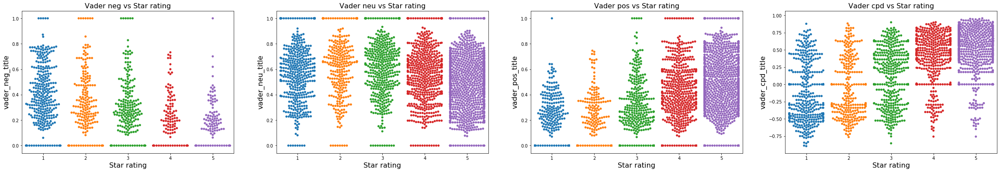

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

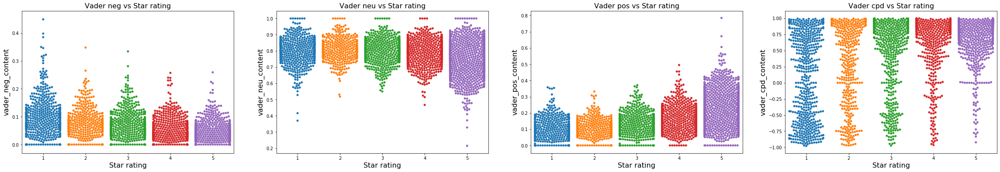

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [35]:
plot_vs_rez(vs_echoshow1,title_rez)
plot_vs_rez(vs_echoshow1,content_rez)

Sentiment analysis of Echo Show Gen 2:

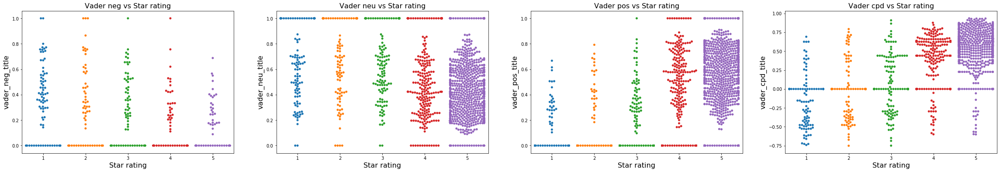

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

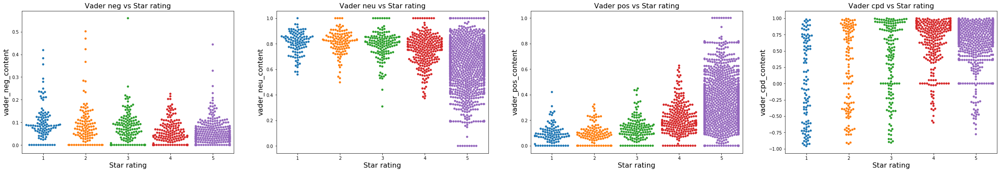

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [36]:
plot_vs_rez(vs_echoshow2,title_rez)
plot_vs_rez(vs_echoshow2,content_rez)

Sentiment analysis of Echo Spot Gen 1:

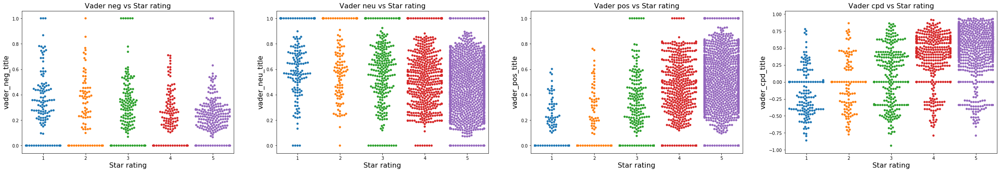

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

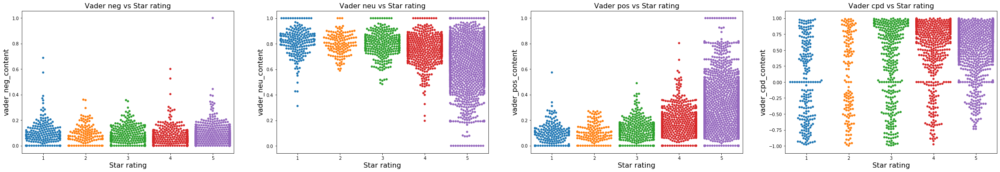

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [37]:
plot_vs_rez(vs_echospot1,title_rez)
plot_vs_rez(vs_echospot1,content_rez)

Sentiment analysis of Echo Plus Gen 1:

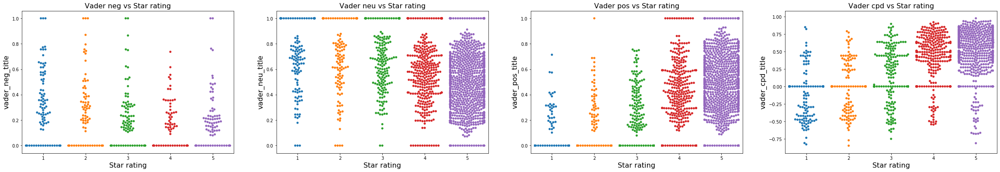

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

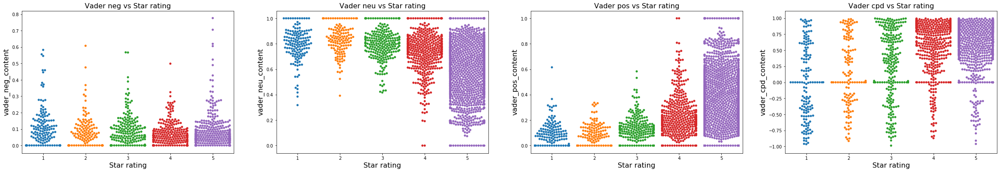

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [38]:
plot_vs_rez(vs_echoplus1,title_rez)
plot_vs_rez(vs_echoplus1,content_rez)

Sentiment analysis of Echo Plus Gen 2:

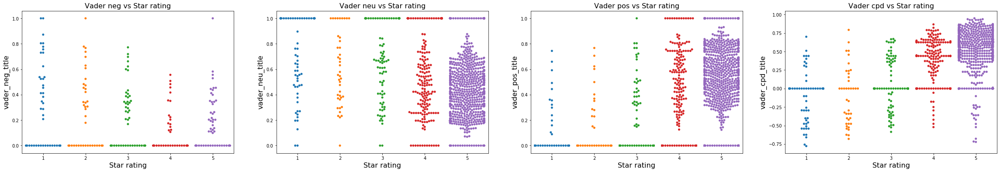

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

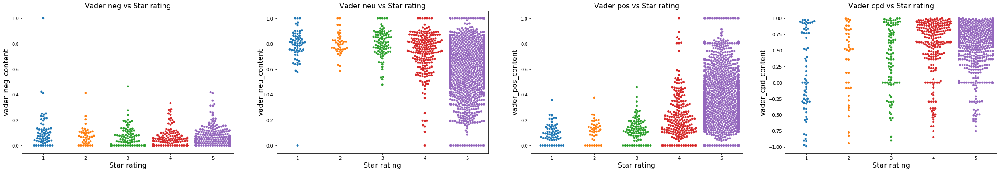

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [39]:
plot_vs_rez(vs_echoplus2,title_rez)
plot_vs_rez(vs_echoplus2,content_rez)

For each product, the VADER scores are plotted against the star ratings in swamp plots, and all reviews are colored based on star rating. Overall, the distribution of the compound scores appear to be in agreement with the review’s star ratings. Focusing on the analyses of review contents, the Cpd score plots show that, for all products, the majority of 5-star reviews scores above 0.05, reflecting the positive sentiments expressed in these reviews. As star rating decreases, more reviews are scored below 0, which indicates negative sentiments. The score distributions of 1- and 2-star reviews, however, do not mirror the 4- and 5-star reviews. Instead, at the other end of the spectrum, about half of the 1-star reviews score above 0 and the other half below 0. In addition, data points appear to be evenly distributed from -1 to 1 for most devices except for Echo Show 1st Generation, which has an uneven distribution with more reviews scored at either extreme (-1 or 1) and less scored as neutral, i.e. around 0. In other words, many reviews with low star rating have a positive score, many of which score similarly as 1 just like a 5-star reviews. 

The Pos, Neu, and Neg scores provide additional insights into how reviews are scored in this sentiment analysis. Similar to the Compound scores, the distributions of Pos and Neg scores appear to agree with the star ratings. Most 5-star reviews have Pos scores ranging from 0 and 0.8 and Neg scores ranging from 0 to 0.2, indicating a 5-star review could have up to 80% of positive text and 20% of negative text. On the other hand, most 1-star reviews have Pos scores ranging from 0 to 0.2 and Neg scores ranging from 0 and 0.2, reflecting a 1-star review could have up to 20% of positive text as well as 20% of negative text. The big difference in Pos scores and small difference in Neg scores suggest that reviews, regardless of star ratings, share similar relative amount of negative text, and relative amount of the positive text increases as the star rating increases. Interestingly, many of the reviews, independent of star rating, have a Neu score above 0.5, implying that more than 50% of the contents in these reviews are rated neutral, and those scored below 0.5 are primarily 5-star reviews. 


Another look at the review length:

In [40]:
def plot_x_col_y_vs_rez(df,xcol,ycols):

    f = plt.figure(figsize=(40,10))
    ax1 = f.add_subplot(141)
    ax2 = f.add_subplot(142)
    ax3 = f.add_subplot(143)
    ax4 = f.add_subplot(144)

    plt_title1 = "Vader neg vs "+xcol
    g1 = plt.figure(figsize=(10,10))
    g1 = sns.scatterplot(x=df[xcol],y=df[ycols[0]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax1)
    g1.set_title(plt_title1,fontsize=20)
    g1.set_xlabel(xcol,fontsize=20)
    g1.set_ylabel(ycols[0],fontsize=20)

    plt_title2 = "Vader neu vs "+xcol
    g2 = plt.figure(figsize=(10,10))
    g2 = sns.scatterplot(x=df[xcol],y=df[ycols[1]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax2)
    g2.set_title(plt_title2,fontsize=20)
    g2.set_xlabel(xcol,fontsize=20)
    g2.set_ylabel(ycols[1],fontsize=20)    
    
    plt_title3 = "Vader pos vs "+xcol
    g3 = plt.figure(figsize=(10,10))
    g3 = sns.scatterplot(x=df[xcol],y=df[ycols[2]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax3)
    g3.set_title(plt_title3,fontsize=20)
    g3.set_xlabel(xcol,fontsize=20)
    g3.set_ylabel(ycols[2],fontsize=20)    

    plt_title4 = "Vader cpd vs "+xcol
    g4 = plt.figure(figsize=(10,10))
    g4 = sns.scatterplot(x=df[xcol],y=df[ycols[3]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax4)
    g4.set_title(plt_title4,fontsize=20)
    g4.set_xlabel(xcol,fontsize=20)
    g4.set_ylabel(ycols[3],fontsize=20)    

    
    plt.show()  

VADER analysis vs review title/contents length:

Echo Show Gen 1:

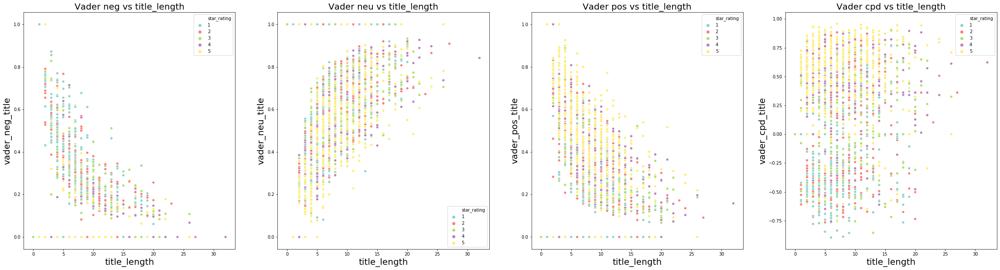

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

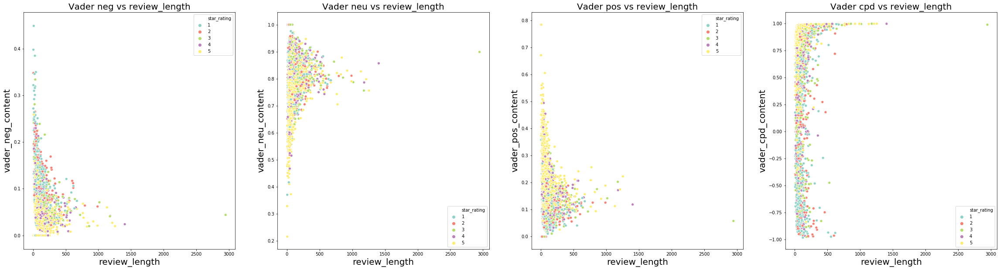

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [41]:
plot_x_col_y_vs_rez(vs_echoshow1,'title_length',title_rez)
plot_x_col_y_vs_rez(vs_echoshow1,'review_length',content_rez)

Echo Show Gen 2:

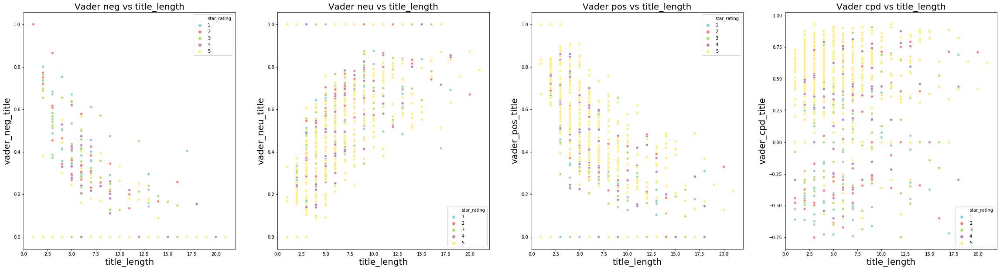

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

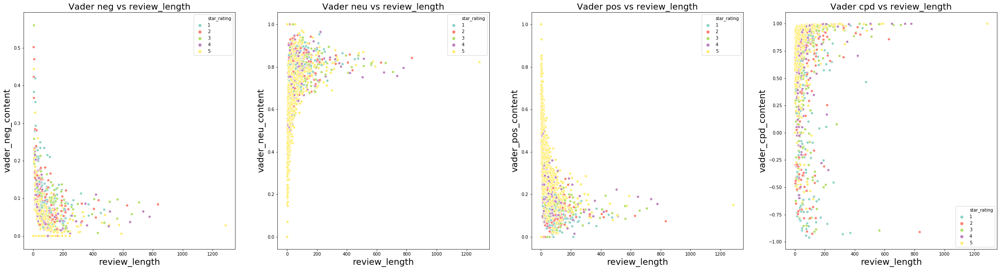

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [42]:
plot_x_col_y_vs_rez(vs_echoshow2,'title_length',title_rez)
plot_x_col_y_vs_rez(vs_echoshow2,'review_length',content_rez)

Echo Spot Gen 1:

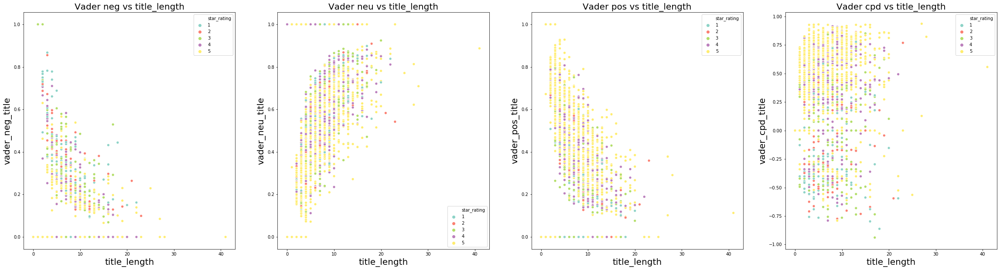

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

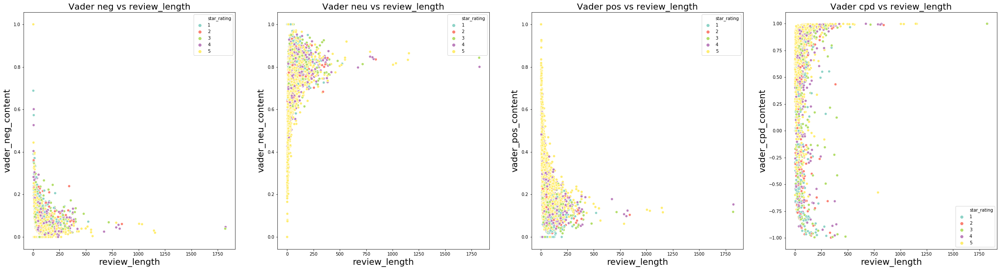

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [43]:
plot_x_col_y_vs_rez(vs_echospot1,'title_length',title_rez)
plot_x_col_y_vs_rez(vs_echospot1,'review_length',content_rez)

Echo Plus Gen 1:

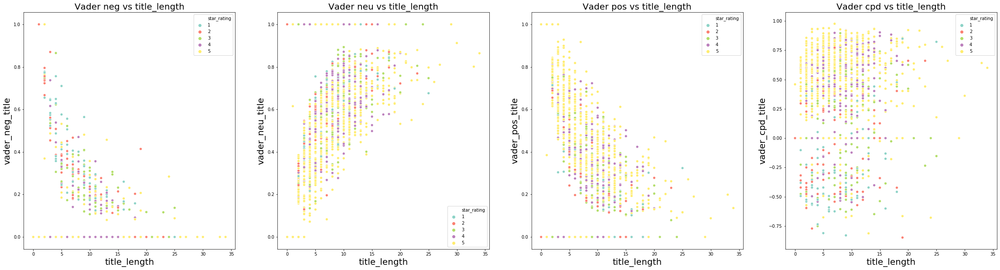

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

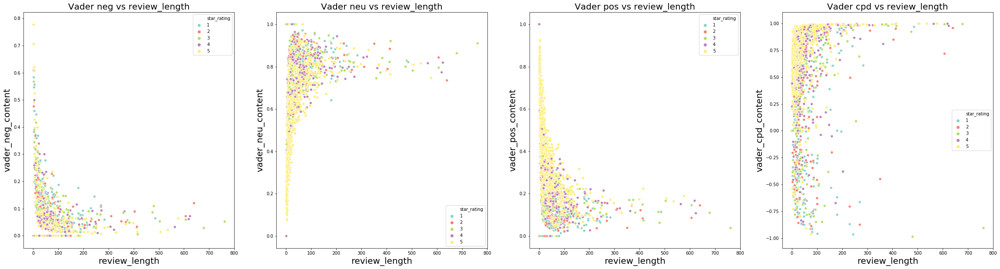

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [44]:
plot_x_col_y_vs_rez(vs_echoplus1,'title_length',title_rez)
plot_x_col_y_vs_rez(vs_echoplus1,'review_length',content_rez)

Echo Plus Gen 2:

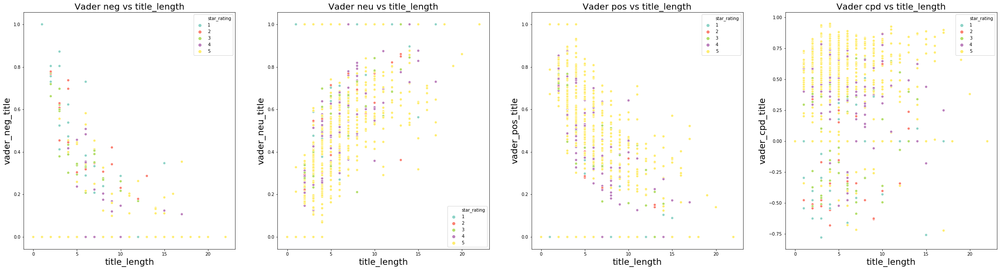

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

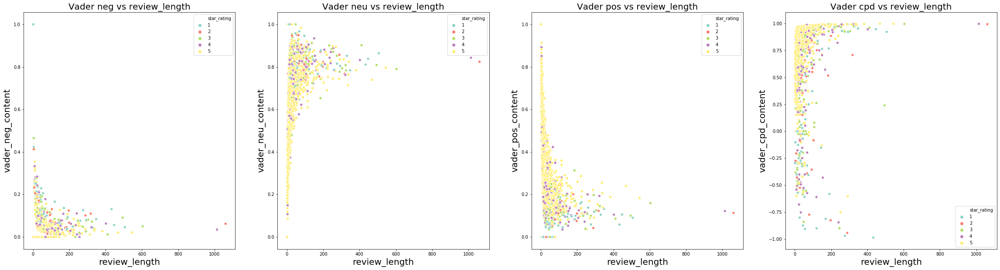

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [45]:
plot_x_col_y_vs_rez(vs_echoplus2,'title_length',title_rez)
plot_x_col_y_vs_rez(vs_echoplus2,'review_length',content_rez)

Ovreall, the graphs look similar for different devices and the review lengths do not seem to correlate with the Compound scores.

Also check any trend across time:

VADER analysis vs review date:

Echo Show Gen 1:

In [46]:
def plot_x_dtcol_y_vs_rez(df,xcol,ycols):
    import matplotlib.dates as mdates

    f = plt.figure(figsize=(40,10))
    ax1 = f.add_subplot(141)
    ax2 = f.add_subplot(142)
    ax3 = f.add_subplot(143)
    ax4 = f.add_subplot(144)

    plt_title1 = "Vader neg vs "+xcol
    g1 = plt.figure(figsize=(10,10))
    g1 = sns.scatterplot(x=df[xcol],y=df[ycols[0]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax1)
    g1.set_title(plt_title1,fontsize=20)
    g1.set_xlabel(xcol,fontsize=20)
    g1.set_ylabel(ycols[0],fontsize=20)
    g1.set_xlim(df['date'].min(), df['date'].max())
    dtformat = mdates.DateFormatter('%Y-%m-%d')
    g1.xaxis.set_major_formatter(dtformat)
    for item in g1.get_xticklabels():
        item.set_rotation(45)

    plt_title2 = "Vader neu vs "+xcol
    g2 = plt.figure(figsize=(10,10))
    g2 = sns.scatterplot(x=df[xcol],y=df[ycols[1]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax2)
    g2.set_title(plt_title2,fontsize=20)
    g2.set_xlabel(xcol,fontsize=20)
    g2.set_ylabel(ycols[1],fontsize=20)
    g2.set_xlim(df['date'].min(), df['date'].max())
    dtformat = mdates.DateFormatter('%Y-%m-%d')
    g2.xaxis.set_major_formatter(dtformat)
    for item in g2.get_xticklabels():
        item.set_rotation(45)
    
    plt_title3 = "Vader pos vs "+xcol
    g3 = plt.figure(figsize=(10,10))
    g3 = sns.scatterplot(x=df[xcol],y=df[ycols[2]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax3)
    g3.set_title(plt_title3,fontsize=20)
    g3.set_xlabel(xcol,fontsize=20)
    g3.set_ylabel(ycols[2],fontsize=20)
    g3.set_xlim(df['date'].min(), df['date'].max())
    dtformat = mdates.DateFormatter('%Y-%m-%d')
    g3.xaxis.set_major_formatter(dtformat)
    for item in g3.get_xticklabels():
        item.set_rotation(45)

    plt_title4 = "Vader cpd vs "+xcol
    g4 = plt.figure(figsize=(10,10))
    g4 = sns.scatterplot(x=df[xcol],y=df[ycols[3]],hue=df['star_rating'],legend="full",palette="Set3",ax=ax4)
    g4.set_title(plt_title4,fontsize=20)
    g4.set_xlabel(xcol,fontsize=20)
    g4.set_ylabel(ycols[3],fontsize=20)
    g4.set_xlim(df['date'].min(), df['date'].max())
    dtformat = mdates.DateFormatter('%Y-%m-%d')
    g4.xaxis.set_major_formatter(dtformat)
    for item in g4.get_xticklabels():
        item.set_rotation(45)

    
    plt.show()  

/Users/siegfried/anaconda3/lib/python3.7/site-packages/pandas/plotting/_matplotlib/converter.py:103: FutureWarning: Using an implicitly registered datetime converter for a matplotlib plotting method. The converter was registered by pandas on import. Future versions of pandas will require you to explicitly register matplotlib converters.

To register the converters:
	>>> from pandas.plotting import register_matplotlib_converters
	>>> register_matplotlib_converters()
  warnings.warn(msg, FutureWarning)


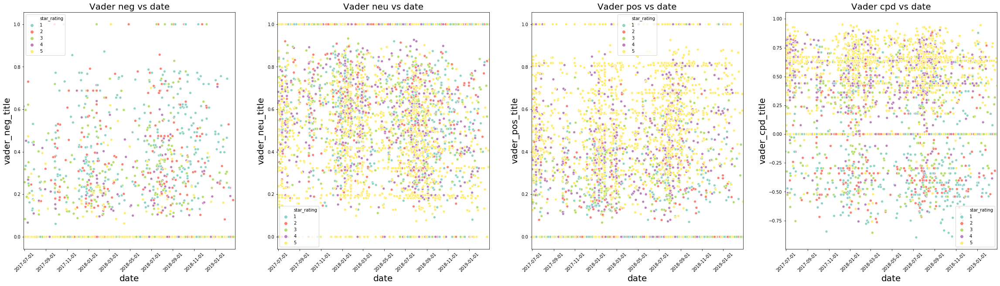

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

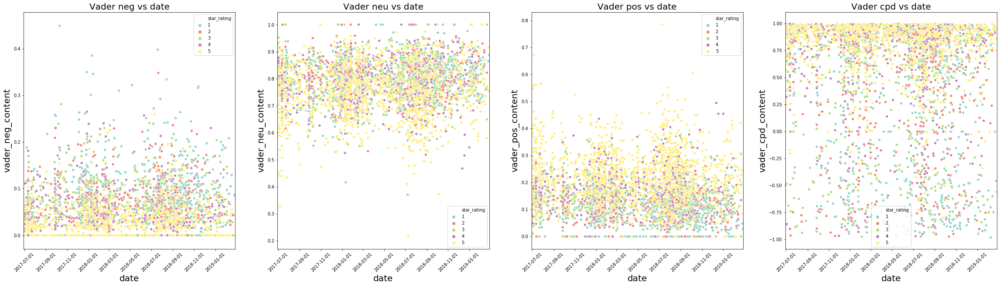

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [47]:
plot_x_dtcol_y_vs_rez(vs_echoshow1,'date',title_rez)
plot_x_dtcol_y_vs_rez(vs_echoshow1,'date',content_rez)

Echo Show Gen 2:

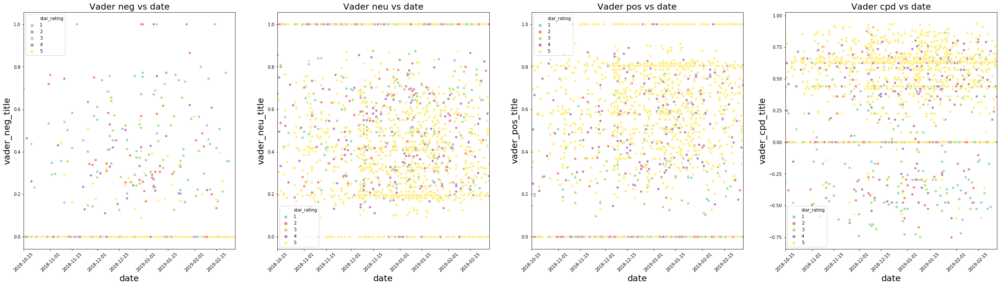

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

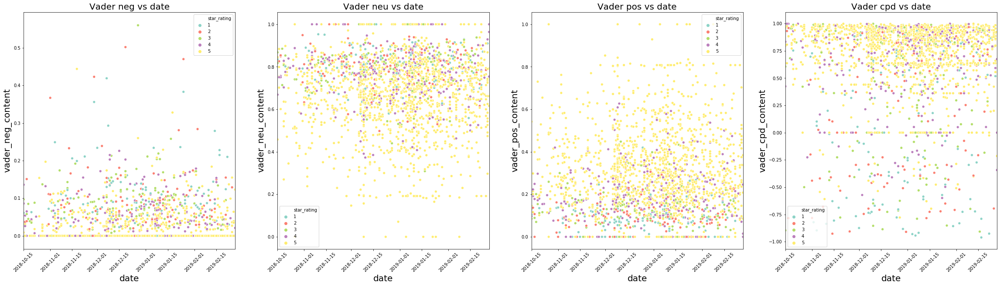

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [48]:
plot_x_dtcol_y_vs_rez(vs_echoshow2,'date',title_rez)
plot_x_dtcol_y_vs_rez(vs_echoshow2,'date',content_rez)

Echo Spot Gen 1:

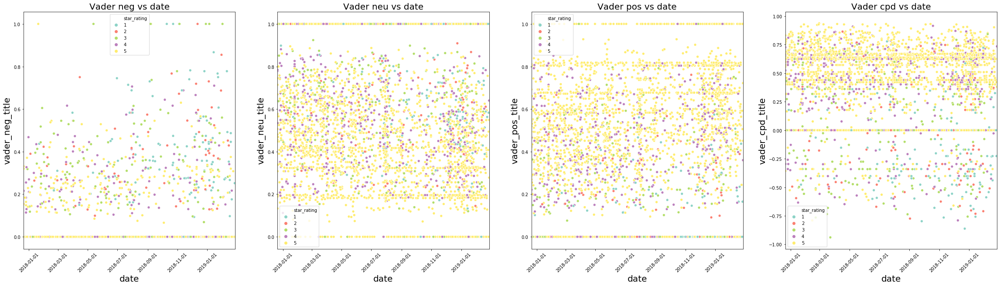

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

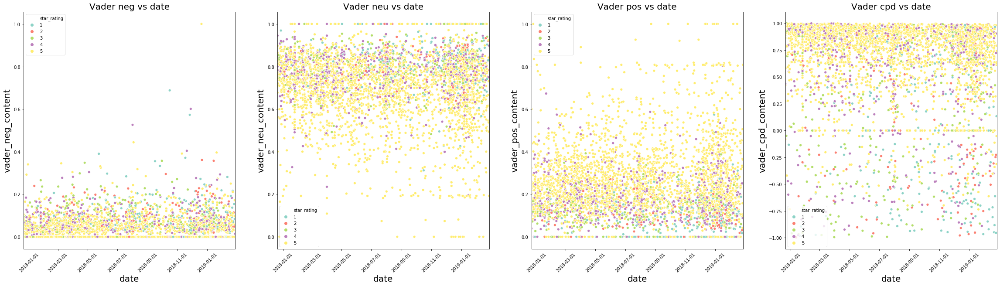

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [49]:
plot_x_dtcol_y_vs_rez(vs_echospot1,'date',title_rez)
plot_x_dtcol_y_vs_rez(vs_echospot1,'date',content_rez)

Echo Plus Gen 1:

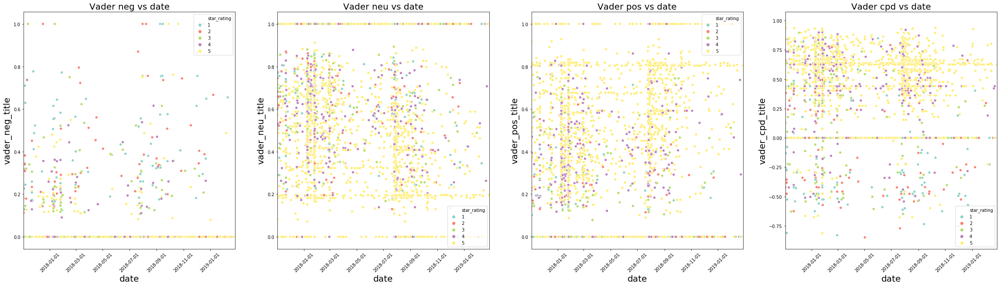

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

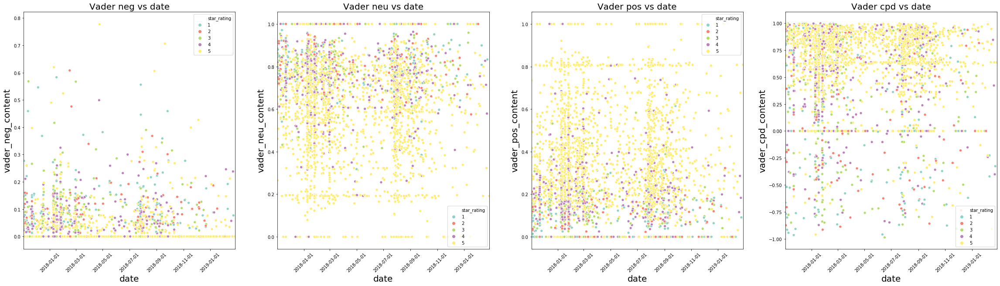

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [50]:
plot_x_dtcol_y_vs_rez(vs_echoplus1,'date',title_rez)
plot_x_dtcol_y_vs_rez(vs_echoplus1,'date',content_rez)

Echo Plus Gen 2:

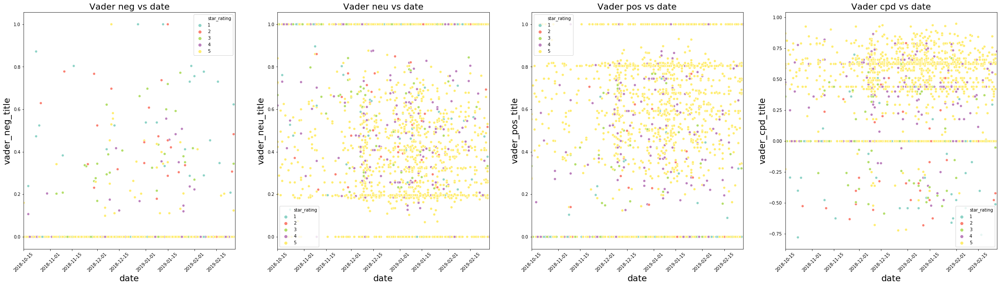

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

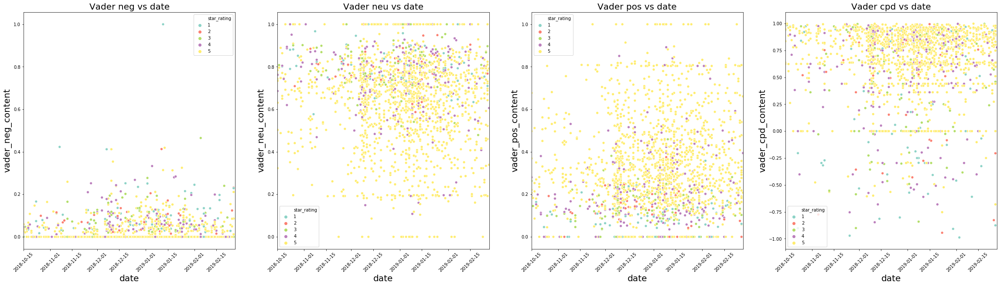

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [51]:
plot_x_dtcol_y_vs_rez(vs_echoplus2,'date',title_rez)
plot_x_dtcol_y_vs_rez(vs_echoplus2,'date',content_rez)

The graphs show no relationship between the Compound scores and time. Instead, some of the graphs do show peaks of review submission after sales events, including after Christmas and after Prime Day. 

Sentiment polarity ratio:

As shown above, while the VADER score distributions appear to make sense, many reviews with low star rating were scored as positive, i.e. Cpd score < 0. Based on the relative proportions of positive, negative, and neutral texts, the amount of positive text appears to be the most significant component that contributes to the sentiment evaluation. Notably, many reviews do score with a low Pos or Neg scores, i.e. close to 0, while many have a large portion of neutral text. As shown in Figure 11, the review lengths could further confound the analysis.

In order to better understand and evaluate both the positive and negative sentiments expressed, a new scoring model was developed to focus on assessing the positive and negative contents. The key concept here is to evaluate the polarity of the sentiments expressed based on the relative proportions of the positive and negative contents. The sentiment polarity, calculated as the ratio of the Pos and Neg scores (Pos/Neg), provides a measure to characterized how polarized the input text is by taking into account of both positive and negative sentiments. In other words, one could evaluate how positive a review is not only by the amount of positive text but also how much negative text is present.

In [52]:
#Apply minimum value of 0.001 for Pos and Neg
def calc_mod_vs_neg_pos(df):
    df['vs_neg_title'] = df.vader_neg_title.replace(0.000,0.001)
    df['vs_pos_title'] = df.vader_pos_title.replace(0.000,0.001)
    df['vs_neg_content'] = df.vader_neg_content.replace(0.000,0.001)
    df['vs_pos_content'] = df.vader_pos_content.replace(0.000,0.001)

def calc_pos_neg_ratio(df):
    calc_mod_vs_neg_pos(df)
    df['pos_neg_ratio_title'] = df.vs_pos_title / df.vs_neg_title
    df['log_ratio_title'] = np.log10(df['pos_neg_ratio_title'])
    df['pos_neg_ratio_content'] = df.vs_pos_content / df.vs_neg_content
    df['log_ratio_content'] = np.log10(df['pos_neg_ratio_content'])

In [53]:
calc_pos_neg_ratio(vs_echoshow1)
calc_pos_neg_ratio(vs_echoshow2)
calc_pos_neg_ratio(vs_echospot1)
calc_pos_neg_ratio(vs_echoplus1)
calc_pos_neg_ratio(vs_echoplus2)

/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  This is separate from the ipykernel package so we can avoid doing imports until
/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  after removing the cwd from sys.path.
/Users/siegfried/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy o

In [54]:
def plot_log_pos_neg_ratio_vs_star(df):

    f = plt.figure(figsize=(20,6))
    ax1 = f.add_subplot(121)
    ax2 = f.add_subplot(122)
    
    plt_title1 = "Titles: Log(VS_Pos/VS_Neg) vs Star rating"
    g1 = plt.figure(figsize=(10,6))   
    g1 = sns.swarmplot(x=df['star_rating'],y=df['log_ratio_title'],ax=ax1)
    g1.set_title(plt_title1,fontsize=20)
    g1.set_xlabel('Star rating',fontsize=20)
    g1.set_ylabel('Log(VS_Pos/VS_Neg)',fontsize=20)

    plt_title2 = "Reviews: Log(VS_Pos/VS_Neg) vs Star rating"
    g2 = plt.figure(figsize=(10,6))
    g2 = sns.swarmplot(x=df['star_rating'],y=df['log_ratio_content'],ax=ax2)
    g2.set_title(plt_title2,fontsize=20)
    g2.set_xlabel('Star rating',fontsize=20)
    g2.set_ylabel('Log(VS_Pos/VS_Neg)',fontsize=20)    
    
    plt.show()

Echo Show Gen 1:

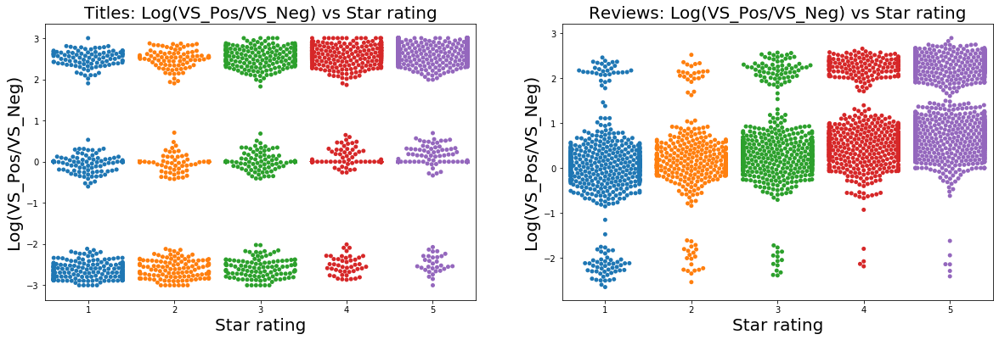

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [55]:
plot_log_pos_neg_ratio_vs_star(vs_echoshow1)

Echo Show Gen 2:

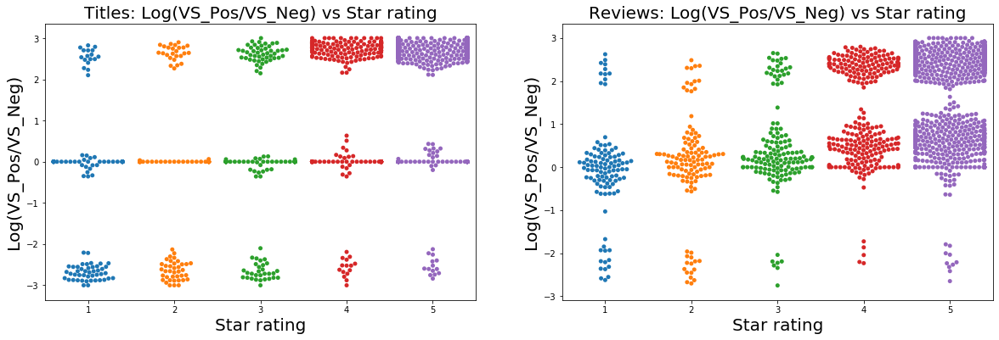

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [56]:
plot_log_pos_neg_ratio_vs_star(vs_echoshow2)

Echo Spot Gen 1:

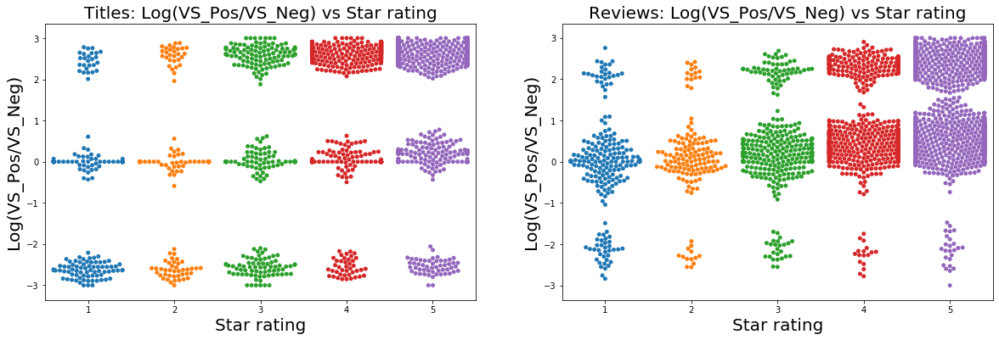

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [57]:
plot_log_pos_neg_ratio_vs_star(vs_echospot1)

Echo Plus Gen 1:

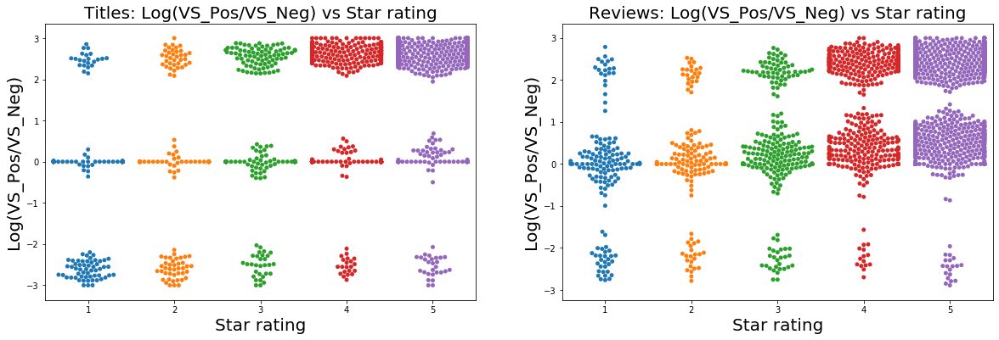

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [58]:
plot_log_pos_neg_ratio_vs_star(vs_echoplus1)

Echo Plus Gen 2:

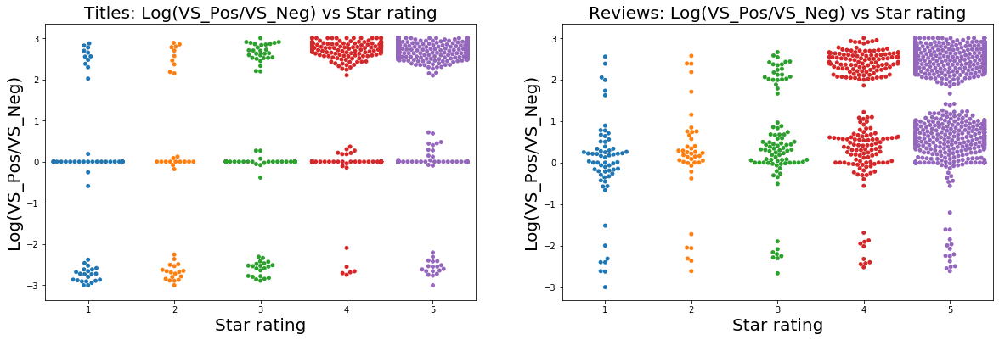

<Figure size 720x432 with 0 Axes>

<Figure size 720x432 with 0 Axes>

In [59]:
plot_log_pos_neg_ratio_vs_star(vs_echoplus2)

For 5-star reviews, the majority of reviews scored Log(Pos/Neg) above 1, i.e. Pos > Neg, indicating that these reviews have more positive text than negative text. On the other hand, the 1-star reviews mostly have Log(Pos/Neg) between -1 and 1, indicating that these review comments are in general “neutral” with about a 10-fold difference between Pos and Neg. As discussed above, some of the reviews have VADER Cpd score inconsistent with the corresponding star rating, such as those 5-star reviews with Cpd score < 0.05 or 1-star reviews with Cpd score > 0.05. Taking the Pos/Neg ratio as a sentiment measure also helps to reduce the number of such cases, i.e. those with at least 100-fold difference between Pos and Neg, including 5-star reviews Log(Pos/Neg) < -2 and 1-star reviews with Log(Pos/Neg) > 2. Most importantly, the Pos/Neg ratio is interpretable. For example, for a review with Log(Pos/Neg) = 2, or Pos/Neg = 100, the result indicates that the review has 100 positive words for every negative word, which really reflects a high level of satisfaction and high star rating.

To provide a similar unidimensional measure of the sentiments like the VADER Cpd score, the geomean of the Pos/Neg ratios is calculated for each star rating group. 

In [60]:
def calc_gmean_vs_ratio(df,label):
    product_list=[]
    stars=[1,2,3,4,5]
    star_list = []
    gm_title_list=[]
    gm_content_list=[]
    #gm = pd.DataFrame({'Product'})
    for star in stars:
        star_list.append(star)
        product_list.append(label)
        subdf=df[df['star_rating']==star]
        gm_title_list.append(stats.gmean(subdf['pos_neg_ratio_title'],axis=0))
        gm_content_list.append(stats.gmean(subdf['pos_neg_ratio_content'],axis=0))
    
    gm = pd.DataFrame({'Product': product_list,
                       'Star': star_list,
                       'Gmean_pos_neg_ratio_title':gm_title_list,
                       'Gmean_pos_neg_ratio_content':gm_content_list                   
                      })
    gm['Log_Gmean_ratio_title']=np.log(gm['Gmean_pos_neg_ratio_title'])
    gm['Log_Gmean_ratio_content']=np.log(gm['Gmean_pos_neg_ratio_content'])
    return(gm)


In [61]:
es1 = calc_gmean_vs_ratio(vs_echoshow1,'Echo Show Gen 1')
es2 = calc_gmean_vs_ratio(vs_echoshow2,'Echo Show Gen 2')
et1 = calc_gmean_vs_ratio(vs_echospot1,'Echo Spot Gen 1')
ep1 = calc_gmean_vs_ratio(vs_echoplus1,'Echo Plus Gen 1')
ep2 = calc_gmean_vs_ratio(vs_echoplus2,'Echo Plus Gen 2')

In [62]:
ratio_analysis = pd.concat([es1,es2,et1,ep1,ep2])
ratio_analysis

,Product,Star,Gmean_pos_neg_ratio_title,Gmean_pos_neg_ratio_content,Log_Gmean_ratio_title,Log_Gmean_ratio_content
0,Echo Show Gen 1,1,0.265136,0.974669,-1.327513,-0.025657
1,Echo Show Gen 1,2,0.540498,1.453955,-0.615264,0.374287
2,Echo Show Gen 1,3,2.714506,2.876789,0.998610,1.056675
3,Echo Show Gen 1,4,42.623063,7.850256,3.752395,2.060546
4,Echo Show Gen 1,5,112.401773,31.494072,4.722080,3.449799
0,Echo Show Gen 2,1,0.182539,0.850436,-1.700789,-0.162006
1,Echo Show Gen 2,2,0.504737,1.082292,-0.683718,0.079081
2,Echo Show Gen 2,3,1.905586,2.659749,0.644789,0.978232
3,Echo Show Gen 2,4,42.796287,18.397214,3.756451,2.912199
4,Echo Show Gen 2,5,143.233834,103.657670,4.964478,4.641094


In [63]:
def lineplot_x_star_y_ratio_rez(df):
    import matplotlib.dates as mdates

    f = plt.figure(figsize=(40,10))
    ax1 = f.add_subplot(141)
    ax2 = f.add_subplot(142)
    ax3 = f.add_subplot(143)
    ax4 = f.add_subplot(144)
    
    sns.set(style="ticks", rc={"lines.linewidth": 3.0, 'lines.markersize': 10})
    
    plt_title1 = "Titles: Gmean Pos/Neg ratio vs Star"
    g1 = plt.figure(figsize=(10,10))
    #g1.set(xlim=(0,6),xticks=[0,6,1])
    g1 = sns.lineplot(x=df['Star'],y=df['Gmean_pos_neg_ratio_title'],hue=df['Product'],
                         marker="o",style=df['Screen'],legend="full",palette="Set2",ax=ax1)
    g1.set_title(plt_title1,fontsize=20)
    g1.set_xlabel('Star',fontsize=20)
    g1.set_ylabel('Gmean Pos/Neg ratio',fontsize=20)
    g1.set(xlim=(1,5),xticks=[1,2,3,4,5])
    g1.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1)
    
    plt_title2 = "Titles: Log(Gmean Pos/Neg ratio) vs Star"
    g2 = plt.figure(figsize=(10,10))
    g2 = sns.lineplot(x=df['Star'],y=df['Log_Gmean_ratio_title'],hue=df['Product'],
                         marker="o",style=df['Screen'],legend="full",palette="Set2",ax=ax2)
    g2.set_title(plt_title2,fontsize=20)
    g2.set_xlabel('Star',fontsize=20)
    g2.set_ylabel('Log(Gmean Pos/Neg ratio)',fontsize=20)
    g2.set(xlim=(1,5),xticks=[1,2,3,4,5])
    g2.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1)
    
    plt_title3 = "Reviews: Gmean Pos/Neg ratio vs Star"
    g3 = plt.figure(figsize=(10,10))
    g3 = sns.lineplot(x=df['Star'],y=df['Gmean_pos_neg_ratio_content'],hue=df['Product'],
                         marker="o",style=df['Screen'],legend="full",palette="Set2",ax=ax3)
    g3.set_title(plt_title3,fontsize=20)
    g3.set_xlabel('Star',fontsize=20)
    g3.set_ylabel('Gmean Pos/Neg ratio',fontsize=20)
    g3.set(xlim=(1,5),xticks=[1,2,3,4,5])
    g3.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1)
    
    plt_title4 = "Reviews: Log(Gmean Pos/Neg ratio) vs Star"
    g4 = plt.figure(figsize=(10,10))
    g4 = sns.lineplot(x=df['Star'],y=df['Log_Gmean_ratio_content'],hue=df['Product'],
                         marker="o",style=df['Screen'],legend="full",palette="Set2",ax=ax4)
    g4.set_title(plt_title4,fontsize=20)
    g4.set_xlabel('Star',fontsize=20)
    g4.set_ylabel('Log(Gmean Pos/Neg ratio)',fontsize=20)
    g4.set(xlim=(1,5),xticks=[1,2,3,4,5])
    g4.legend(fancybox=True, framealpha=1, shadow=True, borderpad=1)
    
    plt.show()  

Split devices into 2 groups: with screen and without screen.

In [64]:
echo_with_screen = ['Echo Show Gen 1', 'Echo Show Gen 2', 'Echo Spot Gen 1']

In [65]:
ratio_analysis['Screen']=ratio_analysis.Product.isin(echo_with_screen)

In [66]:
has_screen = ratio_analysis.Product.isin(echo_with_screen)
no_screen = ~ratio_analysis.Product.isin(echo_with_screen)

In [67]:
ratio_analysis_with_screen = ratio_analysis[has_screen]
ratio_analysis_no_screen = ratio_analysis[no_screen]

Echo devices with a screen:

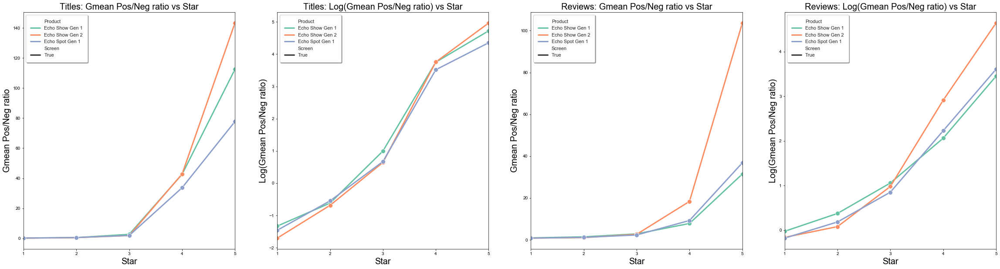

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [68]:
lineplot_x_star_y_ratio_rez(ratio_analysis_with_screen)

Echo devices without a screen:

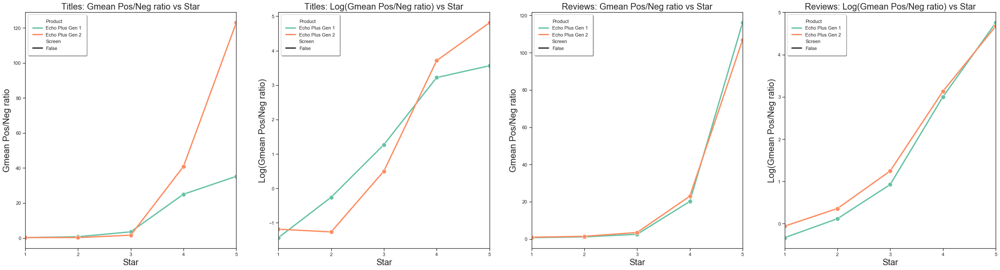

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [69]:
lineplot_x_star_y_ratio_rez(ratio_analysis_no_screen)

All 5 Echo devices in this analysis:

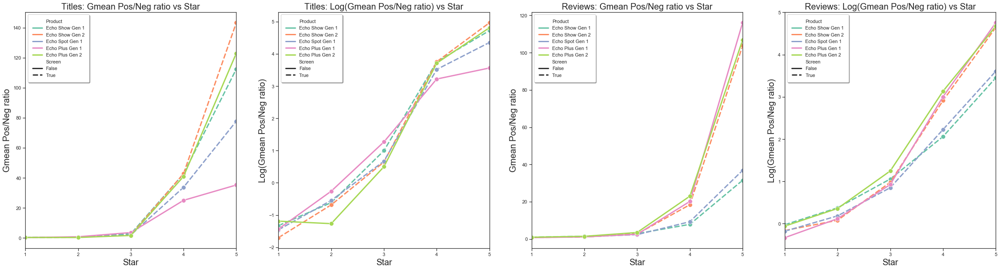

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

<Figure size 720x720 with 0 Axes>

In [70]:
lineplot_x_star_y_ratio_rez(ratio_analysis)

Interestingly, the graph shows two distinct review profiles. With effectively identical sentiment polarity ratios for reviews from 1- to 3-star, the two profiles differ at 4- and 5-star reviews. The higher rating group, which includes Echo Plus 1st Gen, Echo Plus 2nd Gen, and Echo Show 2nd Gen, share polarity ratios of around 20 and 110 for 4- and 5-star reviews, respectively. The lower rating group, including Echo Show 1st Gen and Echo Spot 1st Gen, show polarity ratios of around 10 and 30, for 4- and 5-star reviews, respectively. This result shows that the Echo Plus speakers received more positive reviews than the screen-enabled counterparts, with the exception of Echo Show 2nd Gen, suggesting that the screen-less speakers achieved a higher level of satisfaction without a screen. Relative to the 1st Gen device, the Echo Show 2nd Gen was able to raise the satisfaction level significantly to the same level as that of the Echo Plus speakers. Based on the word cloud analyses as shown in Figure 6, many of the top features of Echo Show 2nd Gen, like the Echo Plus speakers, are related to sound quality and related audio features, which are less prominent in reviews of the 1st Gen device. This appears to suggest that Amazon made Echo Show 2nd Gen a better, more satisfied product by making the device a better smart speaker. In other words, this may reflect that, in early 2019, Echo Show users enjoyed using their screen-enabled devices more as a smart speaker and less so as a multimedia or video call device. 

Potential improvement and next steps:

As the sentiment polarity ratio has provides positive results for this Echo dataset, the study could be expanded to examine newer Echo devices as well as other similar smart devices. The concept of sentiment polarity ratio could also be applied to build a sentiment modeling tool. The bigram and trigram word clouds are shown to be informative but a bit messy. The results could likely be improved by a better data cleaning procedure. 

Conclusions:

Aiming to study whether Echo device is “better” with a screen, this study examined user experience with a selection of 5 Echo devices with and without a screen based on reviews downloaded from Amazon in early 2019. The initial exploratory data analysis shows that the mean star ratings are similar among the 5 selected devices with the Echo Show 1st Gen has the worst rating at 3.7 star in average. However, the data set is shown to be heavily skewed with a disproportionally high number of good reviews. The review length also appears to correlate with the mean rating. Focusing on analyses that would not be influenced by the skewed distribution and review length, word cloud analyses were performed to identify popular and good features from 5-star reviews and issues from 1-star reviews. VADER analysis was carried out to further study the sentiment expressed in the reviews. While the outputs of the sentiment analysis basically agree with the reported star ratings, some, especially those with lower star ratings, are questionable, such as numerous 1-star reviews being scored very positively. The overall results are also difficult to interpret. Alternatively, focusing on the goods and bads in the reviews, sentiment polarity ratio is devised to model how polarized the sentiment by computing the ratio of the relative amounts of the positive and negative texts. The sentiment polarity ratios, calculated from the VADER outputs, provide a “cleaner” and interpretable sentiment assessment of the current data. By using the geomeans of the polarity ratios, the reviews could be categorized into two groups: a lowering rating group, which includes Echo Show 1st Gen and Echo Spot 1st Gen, 2 of the 3 screen-enabled devices, and a higher rating group, which includes both screenless Echo Plus speakers and the Echo Show 2nd Gen. Interestingly, in conjunction with the word cloud analysis, Echo Show 2nd Gen achieves a better user satisfaction by having better audio-related features, very similar to that of the fellow screenless Echo smart speakers in the group. This finding appears to suggest that users enjoy using Echo more as a smart speaker, and having an additional screen does not automatically make the device “better”.